# TechnoServe: Sale Pipline Conversion

## Import Data

In [1]:
# Suppressing Warnings
import warnings
warnings.filterwarnings('ignore')
# Importing Pandas and NumPy
import pandas as pd, numpy as np
# Plotting charts
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# Import dataset
df = pd.read_csv("Leads.csv")
df.head()

,Prospect ID,Lead Number,Lead Origin,Lead Source,Do Not Email,Do Not Call,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,...,Get updates on DM Content,Lead Profile,City,Asymmetrique Activity Index,Asymmetrique Profile Index,Asymmetrique Activity Score,Asymmetrique Profile Score,I agree to pay the amount through cheque,A free copy of Mastering The Interview,Last Notable Activity
0,7927b2df-8bba-4d29-b9a2-b6e0beafe620,660737,API,Olark Chat,No,No,0,0.0,0,0.0,...,No,Select,Select,02.Medium,02.Medium,15.0,15.0,No,No,Modified
1,2a272436-5132-4136-86fa-dcc88c88f482,660728,API,Organic Search,No,No,0,5.0,674,2.5,...,No,Select,Select,02.Medium,02.Medium,15.0,15.0,No,No,Email Opened
2,8cc8c611-a219-4f35-ad23-fdfd2656bd8a,660727,Landing Page Submission,Direct Traffic,No,No,1,2.0,1532,2.0,...,No,Potential Lead,Mumbai,02.Medium,01.High,14.0,20.0,No,Yes,Email Opened
3,0cc2df48-7cf4-4e39-9de9-19797f9b38cc,660719,Landing Page Submission,Direct Traffic,No,No,0,1.0,305,1.0,...,No,Select,Mumbai,02.Medium,01.High,13.0,17.0,No,No,Modified
4,3256f628-e534-4826-9d63-4a8b88782852,660681,Landing Page Submission,Google,No,No,1,2.0,1428,1.0,...,No,Select,Mumbai,02.Medium,01.High,15.0,18.0,No,No,Modified


In [3]:
# Check for any duplicated rows
duplicate_rows = df.duplicated()
df[duplicate_rows]

,Prospect ID,Lead Number,Lead Origin,Lead Source,Do Not Email,Do Not Call,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,...,Get updates on DM Content,Lead Profile,City,Asymmetrique Activity Index,Asymmetrique Profile Index,Asymmetrique Activity Score,Asymmetrique Profile Score,I agree to pay the amount through cheque,A free copy of Mastering The Interview,Last Notable Activity


In [4]:
df.shape

(9240, 37)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9240 entries, 0 to 9239
Data columns (total 37 columns):
 #   Column                                         Non-Null Count  Dtype  
---  ------                                         --------------  -----  
 0   Prospect ID                                    9240 non-null   object 
 1   Lead Number                                    9240 non-null   int64  
 2   Lead Origin                                    9240 non-null   object 
 3   Lead Source                                    9204 non-null   object 
 4   Do Not Email                                   9240 non-null   object 
 5   Do Not Call                                    9240 non-null   object 
 6   Converted                                      9240 non-null   int64  
 7   TotalVisits                                    9103 non-null   float64
 8   Total Time Spent on Website                    9240 non-null   int64  
 9   Page Views Per Visit                           9103 

In [6]:
df.describe()

,Lead Number,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Asymmetrique Activity Score,Asymmetrique Profile Score
count,9240.000000,9240.000000,9103.000000,9240.000000,9103.000000,5022.000000,5022.000000
mean,617188.435606,0.385390,3.445238,487.698268,2.362820,14.306252,16.344883
std,23405.995698,0.486714,4.854853,548.021466,2.161418,1.386694,1.811395
min,579533.000000,0.000000,0.000000,0.000000,0.000000,7.000000,11.000000
25%,596484.500000,0.000000,1.000000,12.000000,1.000000,14.000000,15.000000
50%,615479.000000,0.000000,3.000000,248.000000,2.000000,14.000000,16.000000
75%,637387.250000,1.000000,5.000000,936.000000,3.000000,15.000000,18.000000
max,660737.000000,1.000000,251.000000,2272.000000,55.000000,18.000000,20.000000


## Handling Null Data

In [7]:
# Check all null data
df.isnull().sum()/df.shape[0]

Prospect ID                                      0.000000
Lead Number                                      0.000000
Lead Origin                                      0.000000
Lead Source                                      0.003896
Do Not Email                                     0.000000
Do Not Call                                      0.000000
Converted                                        0.000000
TotalVisits                                      0.014827
Total Time Spent on Website                      0.000000
Page Views Per Visit                             0.014827
Last Activity                                    0.011147
Country                                          0.266342
Specialization                                   0.155628
How did you hear about X Education               0.238853
What is your current occupation                  0.291126
What matters most to you in choosing a course    0.293182
Search                                           0.000000
Magazine      

#### First we will drop all variables that have more than 40% null data

In [8]:
# Variables to drop
list_variables_to_drop = ['Lead Quality', 'Asymmetrique Activity Index', 'Asymmetrique Profile Index', 'Asymmetrique Activity Score', 'Asymmetrique Profile Score']

In [9]:
# Drop these variables
df.drop(list_variables_to_drop, axis=1, inplace=True)

In [10]:
# Check all null data again
df.isnull().sum()/df.shape[0]

Prospect ID                                      0.000000
Lead Number                                      0.000000
Lead Origin                                      0.000000
Lead Source                                      0.003896
Do Not Email                                     0.000000
Do Not Call                                      0.000000
Converted                                        0.000000
TotalVisits                                      0.014827
Total Time Spent on Website                      0.000000
Page Views Per Visit                             0.014827
Last Activity                                    0.011147
Country                                          0.266342
Specialization                                   0.155628
How did you hear about X Education               0.238853
What is your current occupation                  0.291126
What matters most to you in choosing a course    0.293182
Search                                           0.000000
Magazine      

#### Variables that have very small percentage of null data < 2%, we drop null data in these variables

In [11]:
# List variables to drop
list_variables_to_drop = ['Lead Source', 'TotalVisits', 'Page Views Per Visit', 'Last Activity']

In [12]:
# Drop null data in these variables
for variable in list_variables_to_drop:
    df.dropna(subset=list_variables_to_drop, inplace=True)

In [13]:
# Check all null data again
df.isnull().sum()/df.shape[0]

Prospect ID                                      0.000000
Lead Number                                      0.000000
Lead Origin                                      0.000000
Lead Source                                      0.000000
Do Not Email                                     0.000000
Do Not Call                                      0.000000
Converted                                        0.000000
TotalVisits                                      0.000000
Total Time Spent on Website                      0.000000
Page Views Per Visit                             0.000000
Last Activity                                    0.000000
Country                                          0.253031
Specialization                                   0.157703
How did you hear about X Education               0.242451
What is your current occupation                  0.295680
What matters most to you in choosing a course    0.297774
Search                                           0.000000
Magazine      

#### Let's see all others variables to decide what to do with them

In [14]:
list_variables_to_drop = df.columns[df.isna().any()].tolist()
list_variables_to_drop

['Country',
 'Specialization',
 'How did you hear about X Education',
 'What is your current occupation',
 'What matters most to you in choosing a course',
 'Tags',
 'Lead Profile',
 'City']

In [15]:

for variable in list_variables_to_drop:
    print(df[variable].value_counts())
    print('Null count:',df[variable].isnull().sum())
    print('--------------------------------------------------------------')

India                   6491
United States             69
United Arab Emirates      53
Singapore                 24
Saudi Arabia              21
United Kingdom            15
Australia                 13
Qatar                     10
Hong Kong                  7
Bahrain                    7
Oman                       6
France                     6
unknown                    5
South Africa               4
Nigeria                    4
Germany                    4
Kuwait                     4
Canada                     4
Sweden                     3
China                      2
Asia/Pacific Region        2
Uganda                     2
Bangladesh                 2
Italy                      2
Belgium                    2
Netherlands                2
Ghana                      2
Philippines                2
Russia                     1
Switzerland                1
Vietnam                    1
Denmark                    1
Tanzania                   1
Liberia                    1
Malaysia      

In [16]:
# For 'Country', we can use mod to fill null values because India is strongly dominant.
# Drop variable: What matters most to you in choosing a course. Because it has only one value 'Better Career Prospects'. So this variable won't help to predict the target variable.
# Drop rows: all others. The number of mod value and null value are very high compared to others. So it's a bad idea to fill these null values with mod becuase its accuracy is not reliable.

In [17]:
# Fill null values with mod in 'Country'
df['Country'].fillna(df['Country'].mode()[0], inplace=True)

In [18]:
# Drop variable 'What matters most to you in choosing a course'
df.drop(['What matters most to you in choosing a course'], axis=1, inplace=True)

In [19]:
# List of variables to drop null values
list_variables_to_drop = df.columns[df.isna().any()].tolist()
list_variables_to_drop

['Specialization',
 'How did you hear about X Education',
 'What is your current occupation',
 'Tags',
 'Lead Profile',
 'City']

In [20]:
# Drop null data in these variables
for variable in list_variables_to_drop:
    df.dropna(subset=list_variables_to_drop, inplace=True)

In [21]:
# Check all null data again
df.isnull().sum()/df.shape[0]

Prospect ID                                 0.0
Lead Number                                 0.0
Lead Origin                                 0.0
Lead Source                                 0.0
Do Not Email                                0.0
Do Not Call                                 0.0
Converted                                   0.0
TotalVisits                                 0.0
Total Time Spent on Website                 0.0
Page Views Per Visit                        0.0
Last Activity                               0.0
Country                                     0.0
Specialization                              0.0
How did you hear about X Education          0.0
What is your current occupation             0.0
Search                                      0.0
Magazine                                    0.0
Newspaper Article                           0.0
X Education Forums                          0.0
Newspaper                                   0.0
Digital Advertisement                   

In [22]:
df.shape

(5666, 31)

# Drop unnecessary variable

Prospect ID and Lead number are variables represent unique row for each lead. One of them is enough, so we will drop Prospect ID and keep Lead number

In [23]:
df.drop(['Prospect ID'], axis=1, inplace=True)

# EDA

### Univariate Analysis

#### Numerical Variables

In [24]:
# Get all numerical variables in dataset
numerical_variables = df.select_dtypes(exclude='object').columns.tolist()
numerical_variables.remove('Lead Number')
numerical_variables

['Converted',
 'TotalVisits',
 'Total Time Spent on Website',
 'Page Views Per Visit']

In [25]:
# Function for univariate analysis
def numberical_univariate_analysis(variables):
    for variable in variables:
        #create subplot figure with having two side by side plots
        fig, axes = plt.subplots(nrows=1,ncols=2,figsize=(12,6))
        
        # first plot
        sns.distplot(df[variable], ax=axes[0])
        axes[0].set_title(variable, fontsize=20, color='red')
        
        # second plot
        sns.boxplot(df[variable], ax=axes[1])
        axes[0].set_title(variable, fontsize=20, color='red')

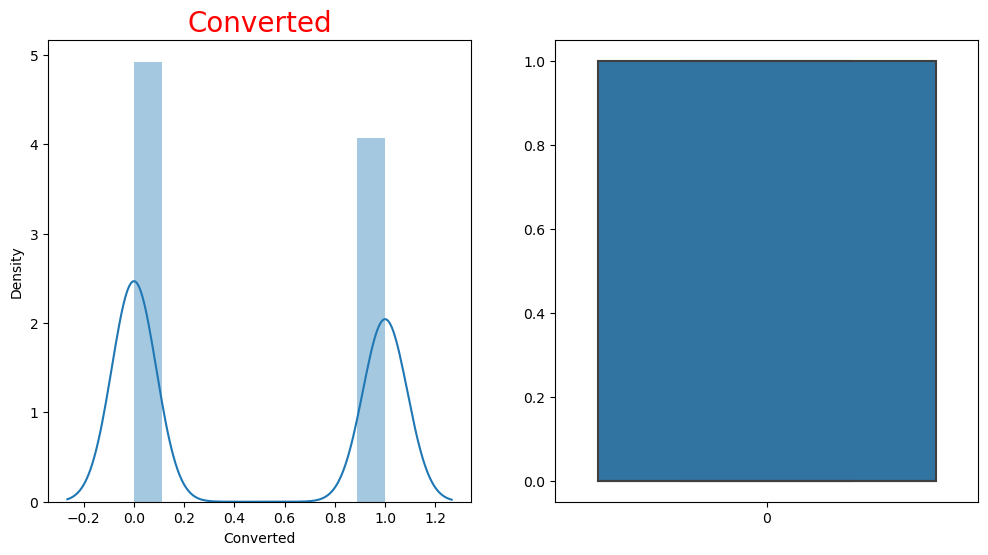

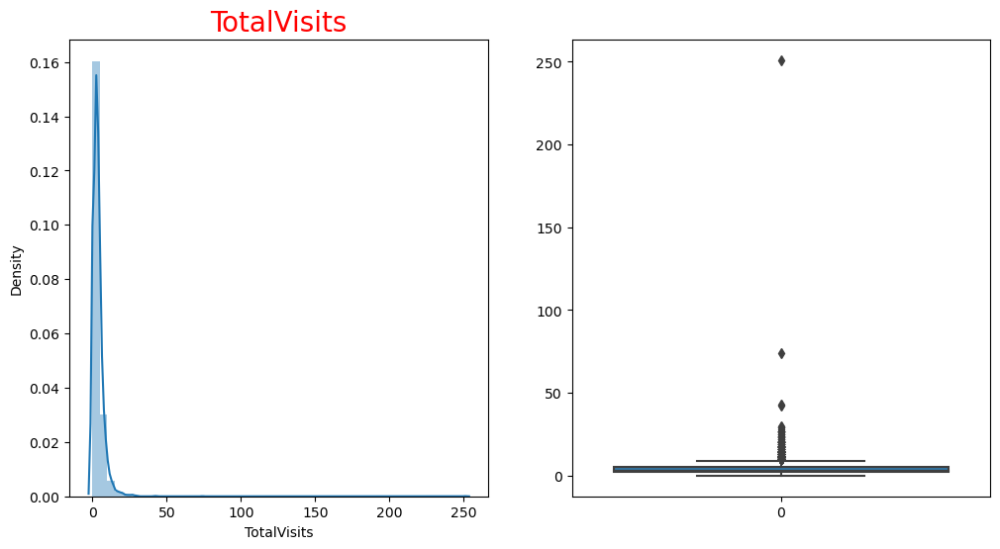

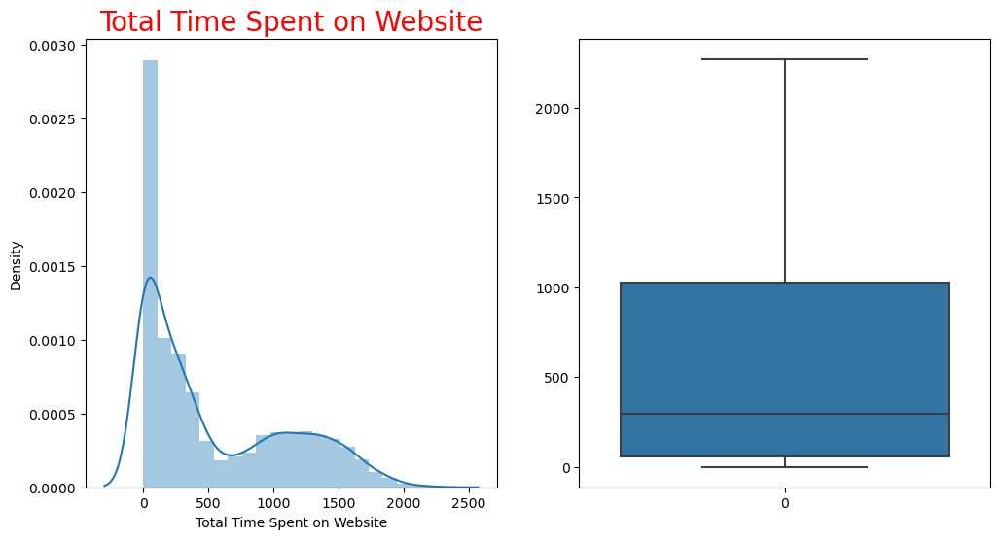

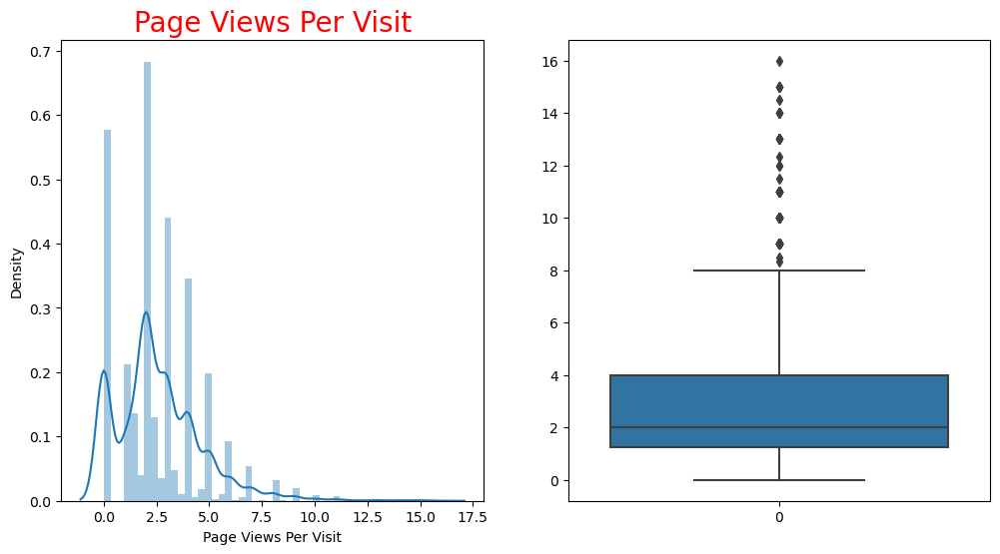

In [26]:
# Run the function
numberical_univariate_analysis(numerical_variables)

- Converted is slightly unbalance.
- Total Visits, "Total Time Spent on Website", "Page Views Per visit" are right skewed. This is make sense because most of the customers will spend their time very little to one webpage, they tend to search for multiple sites. Even though there are outliers, we will not remove them because they represent clients who are interested in TechnoServe. To handling outliers, we will transform these variables into categorical variables by cutting into bins.


#### Categorical Variables

In [27]:
# Get all categorical variables
categorical_variables = df.select_dtypes(exclude=[np.number]).columns.tolist()
categorical_variables

['Lead Origin',
 'Lead Source',
 'Do Not Email',
 'Do Not Call',
 'Last Activity',
 'Country',
 'Specialization',
 'How did you hear about X Education',
 'What is your current occupation',
 'Search',
 'Magazine',
 'Newspaper Article',
 'X Education Forums',
 'Newspaper',
 'Digital Advertisement',
 'Through Recommendations',
 'Receive More Updates About Our Courses',
 'Tags',
 'Update me on Supply Chain Content',
 'Get updates on DM Content',
 'Lead Profile',
 'City',
 'I agree to pay the amount through cheque',
 'A free copy of Mastering The Interview',
 'Last Notable Activity']

In [28]:
# Function for categorical univariate analysis
def categorical_univariate_analysis(variables):
    for variable in variables:
        df[variable].value_counts().plot.barh()
        plt.title(variable, fontsize=20, color='red')
        plt.show()

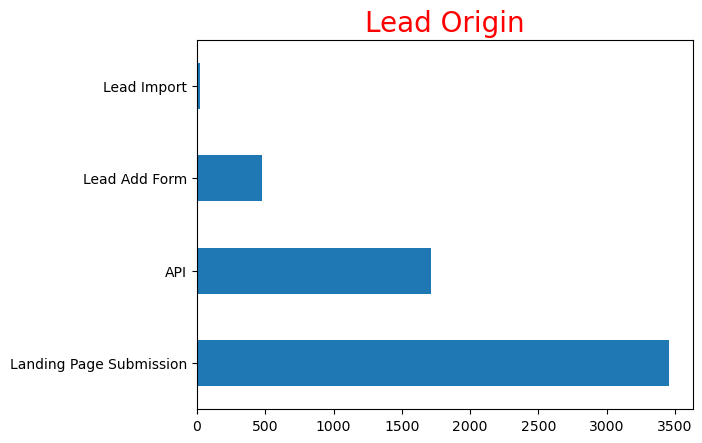

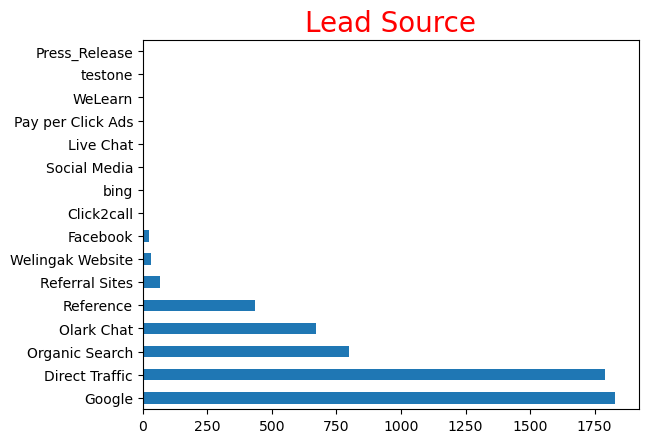

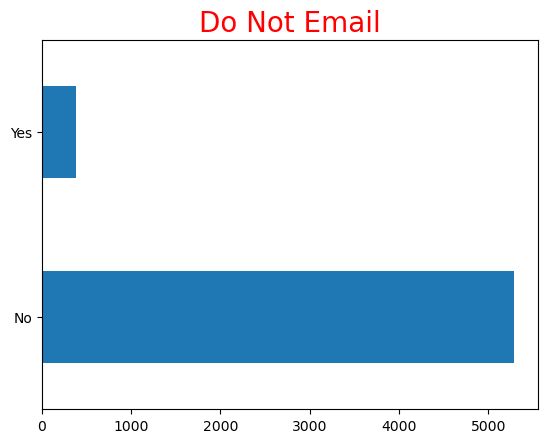

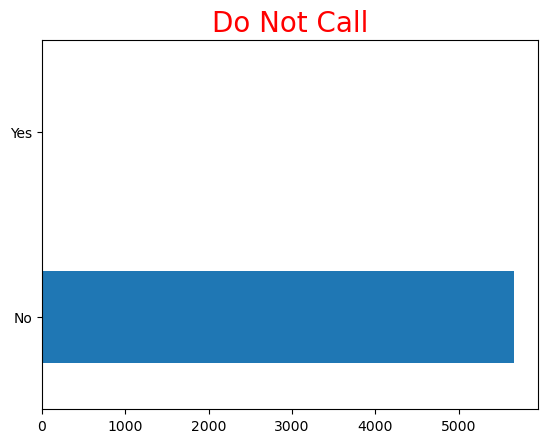

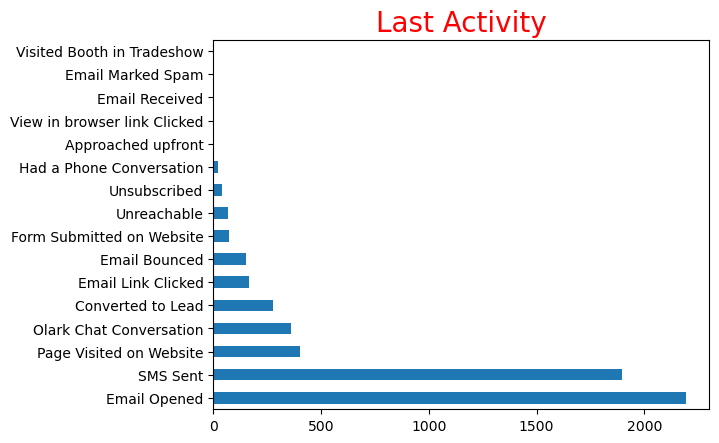

...

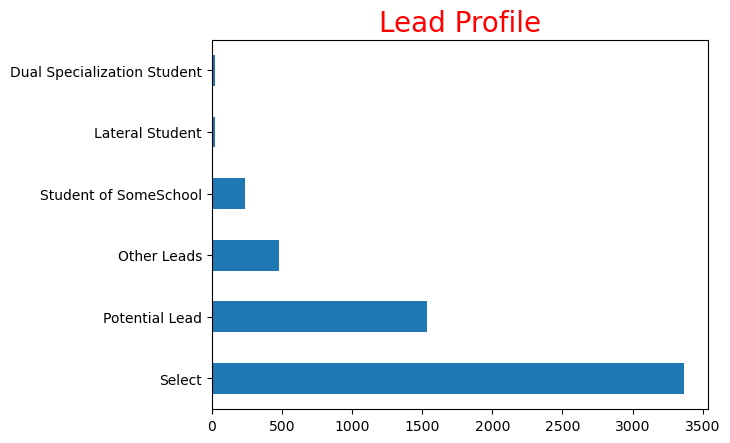

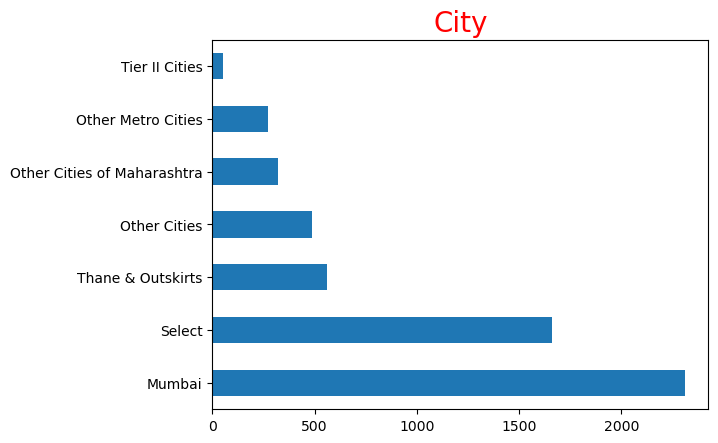

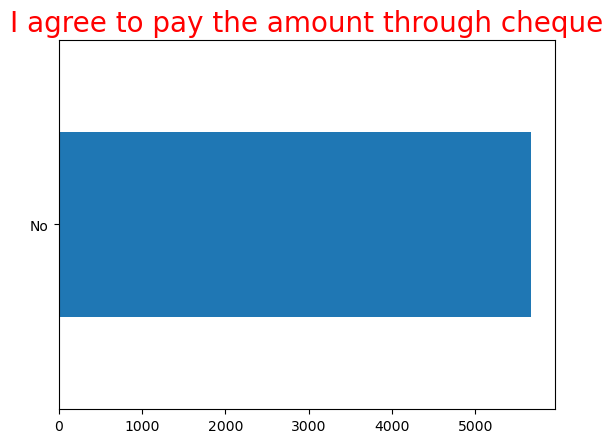

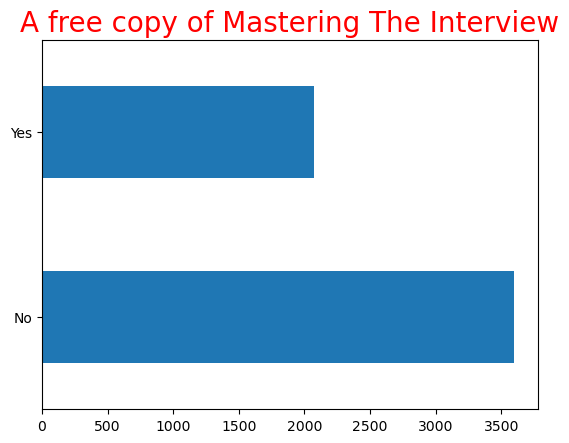

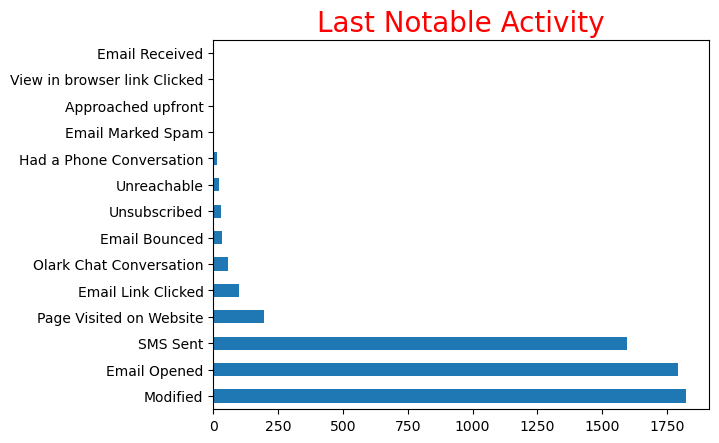

In [29]:
# Run the fucntion
categorical_univariate_analysis(categorical_variables)

- Most of the leads come from "Landing Page Submission" in Lead Origin
- Google is the most popular Lead source.
- Most of the leads want to email and call.
- Most of the leads have "Email Opened" and "SMS Sent" as last activity
- Most of the leads come from India.
- "Finance Management", "Marketing Management", "Human Resource Management" are top 3 popular specializations
- "Online Search", "Word of Mouth", "Studen of SomeSchool" are top 3 ways customers hear about X Education.
- "Unemployed" is dominant in current occupation.
- Almost no lead had seen Search, Magazine, Newspaper, Digital Advertisement ad.
- Almost no customer came in through recommendations.
- No customer want to receive more updates about courses.
- "Will revert after reading the email" is the most popular tag.
- No customer want to receive update on Supply Chain Content, DM Content.
- "Potential Lead" is the most popular lead profile.
- "Mumbai" is the city where most leads come from.
- No customer agree to pay the amount through cheque.
- "Modified", "Email Opened", "SMS Sent" are top 3 most popular activity.

We will remove variables that almost have only 1 option, so no insight in these variables:
- Do Not Call
- Search
- Magazine
- Newspaper Article
- X Education Forums
- Newspaper
- Digital Advertisement
- Through Recommendations
- Receive More Updates About Our Courses
- Update me on Supply Chain Content
- Get updates on DM Content
- I agree to pay the amount through cheque

### Bivariate Analysis

#### Numerical - Numerical Analysis

In [30]:
# We remove Converted from the analysis because it actually categorical variable
numerical_variables.remove('Converted')

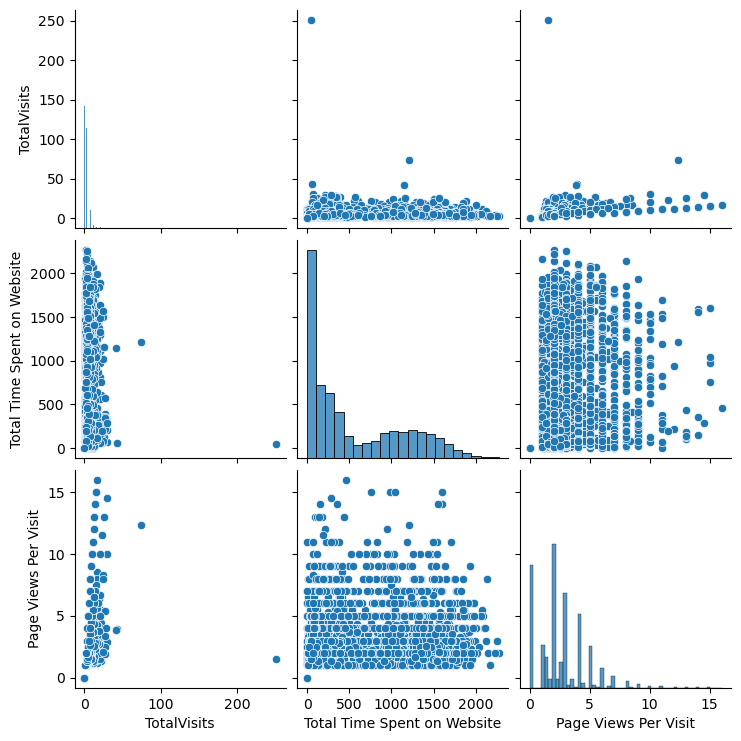

In [31]:
# We use scatter plot to spot if there are relationships between variables
sns.pairplot(df, vars=numerical_variables)
plt.show()

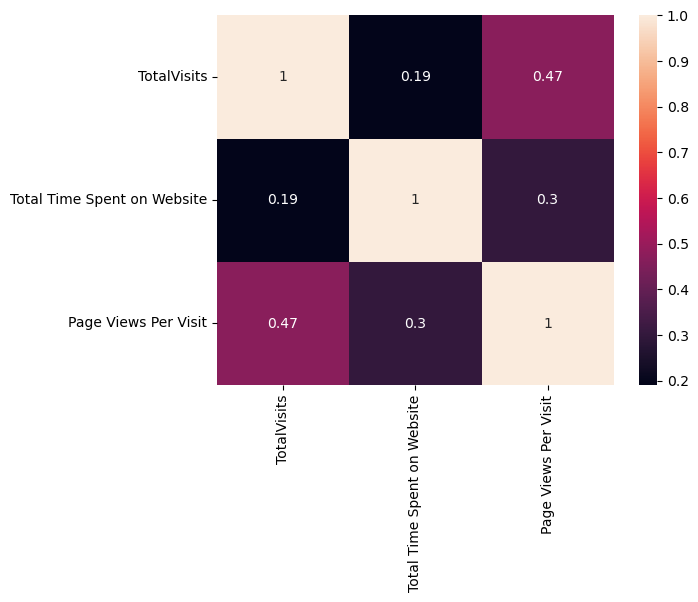

In [32]:
# We use heatmap to identify correlation coefficient between variables
sns.heatmap(df[numerical_variables].corr(), annot=True)
plt.show()

There is no strong linear relationship between these variables.

#### Categorical - Numerical Analysis

In [33]:
# Add Converted as categorical variable
categorical_variables.append('Converted')

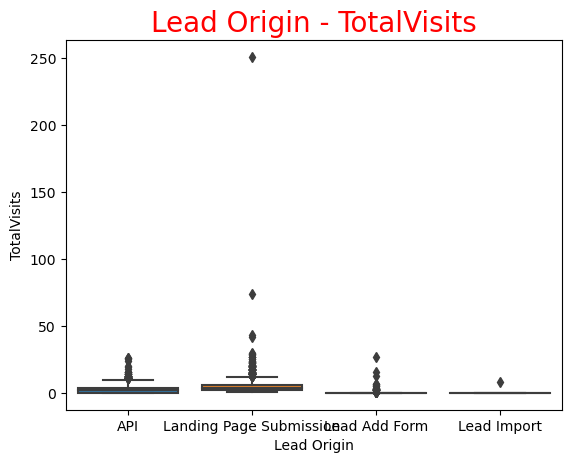

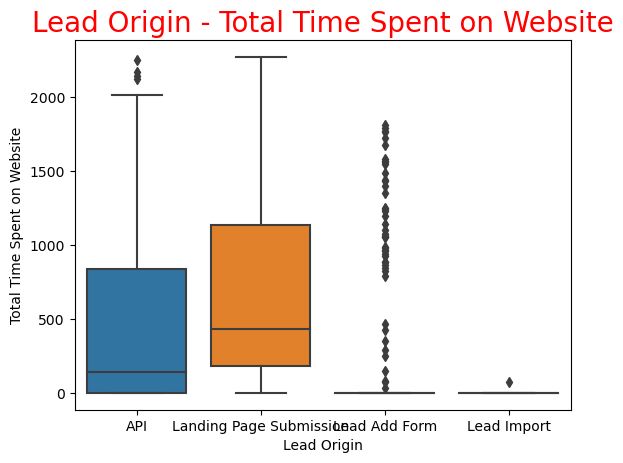

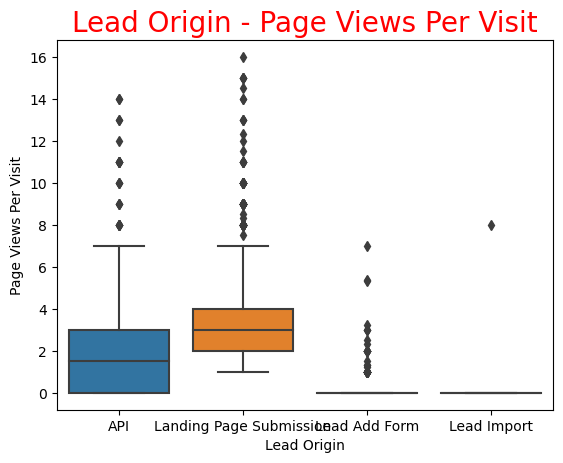

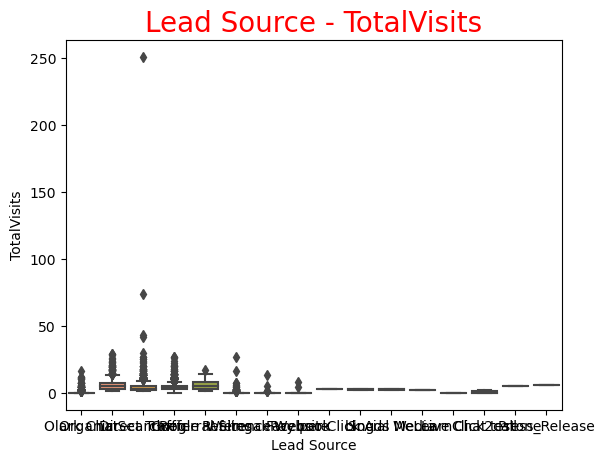

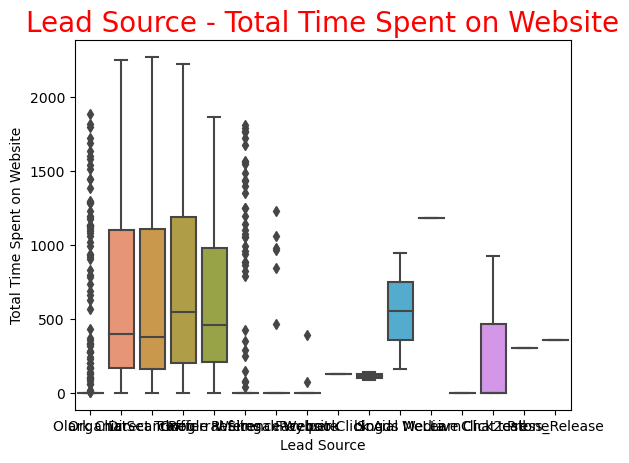

...

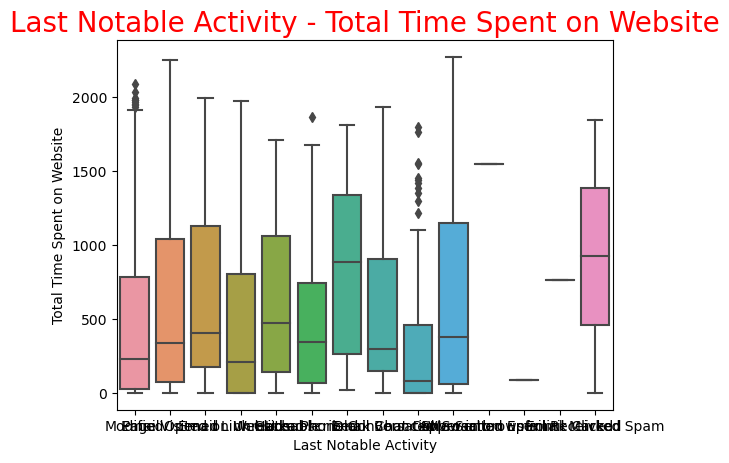

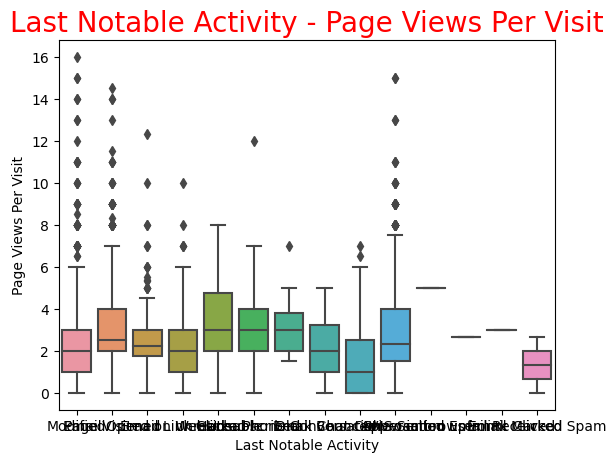

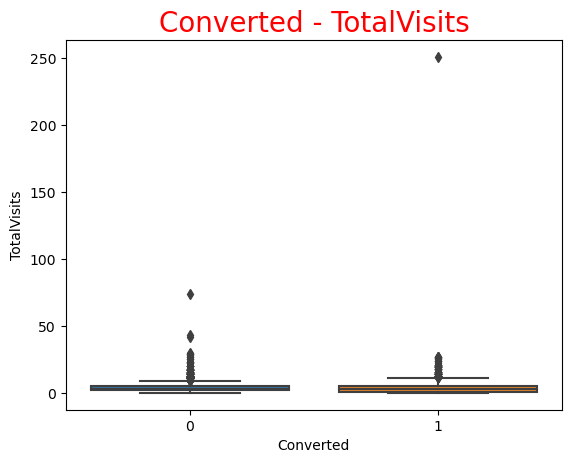

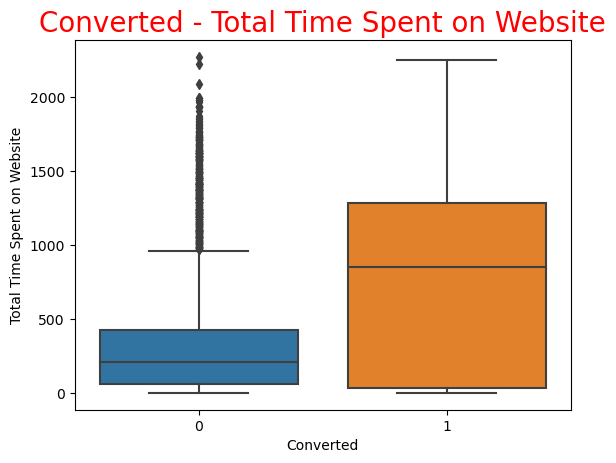

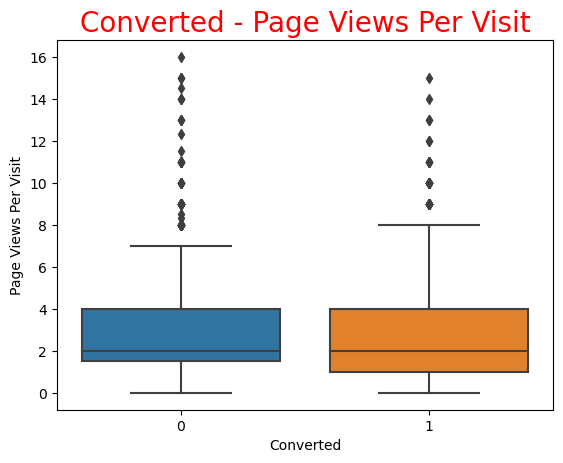

In [34]:
# Loop though all categorical variables and numerical variables and analize data
for categorical_variable in categorical_variables:
    for numerical_variable in numerical_variables:
        sns.boxplot(data=df, x=categorical_variable, y=numerical_variable)
        plt.title(f'{categorical_variable} - {numerical_variable}', fontsize=20, color='red')
        plt.show()

We need to handle outliers in TotalVisits to have clear charts

In [35]:
# Let's get quantile values
df.TotalVisits.quantile([0.25,0.5,0.75,0.95,0.99])

0.25     2.00
0.50     3.00
0.75     5.00
0.95    10.00
0.99    17.35
Name: TotalVisits, dtype: float64

In [36]:
# Let's get max values
df.TotalVisits.max()

251.0

In [37]:
# Create new column TotalofVisits
df['TotalofVisits'] = df[df['TotalVisits'] < 10].TotalVisits

In [38]:
# Check data
df['TotalofVisits'].head()

0    0.0
1    5.0
2    2.0
3    1.0
4    2.0
Name: TotalofVisits, dtype: float64

In [39]:
# Add TotalofVisits and remove TotalVisits
numerical_variables.append('TotalofVisits')
numerical_variables.remove('TotalVisits')

In [40]:
# Check again
categorical_variables

['Lead Origin',
 'Lead Source',
 'Do Not Email',
 'Do Not Call',
 'Last Activity',
 'Country',
 'Specialization',
 'How did you hear about X Education',
 'What is your current occupation',
 'Search',
 'Magazine',
 'Newspaper Article',
 'X Education Forums',
 'Newspaper',
 'Digital Advertisement',
 'Through Recommendations',
 'Receive More Updates About Our Courses',
 'Tags',
 'Update me on Supply Chain Content',
 'Get updates on DM Content',
 'Lead Profile',
 'City',
 'I agree to pay the amount through cheque',
 'A free copy of Mastering The Interview',
 'Last Notable Activity',
 'Converted']

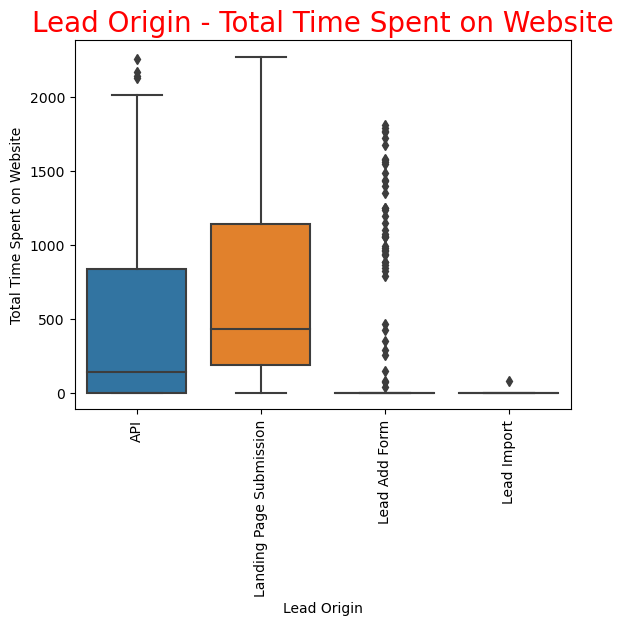

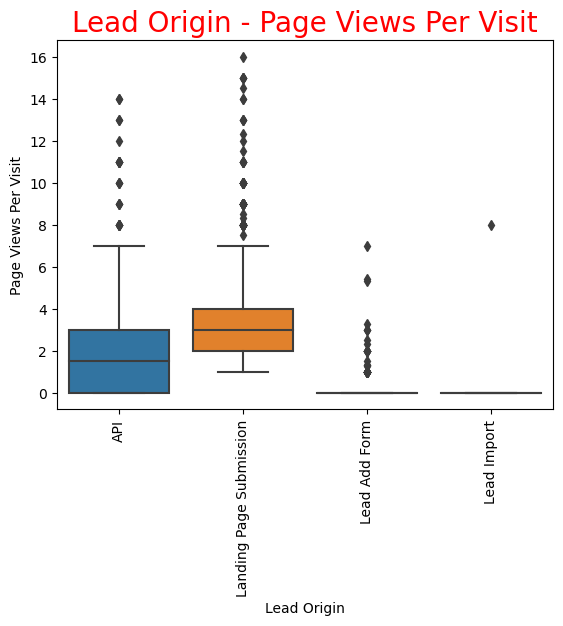

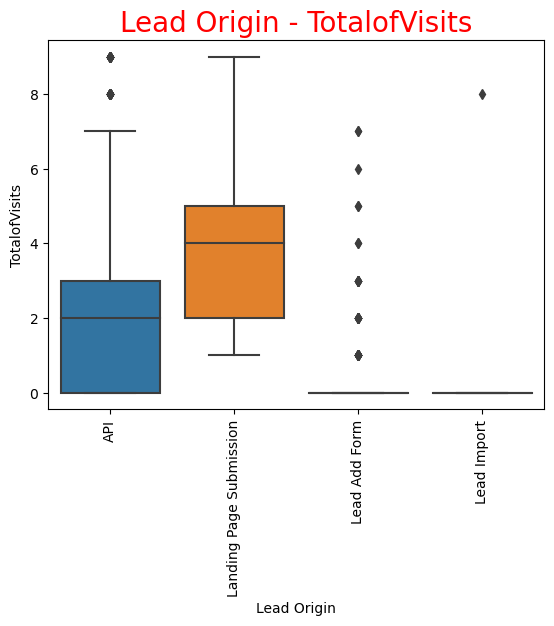

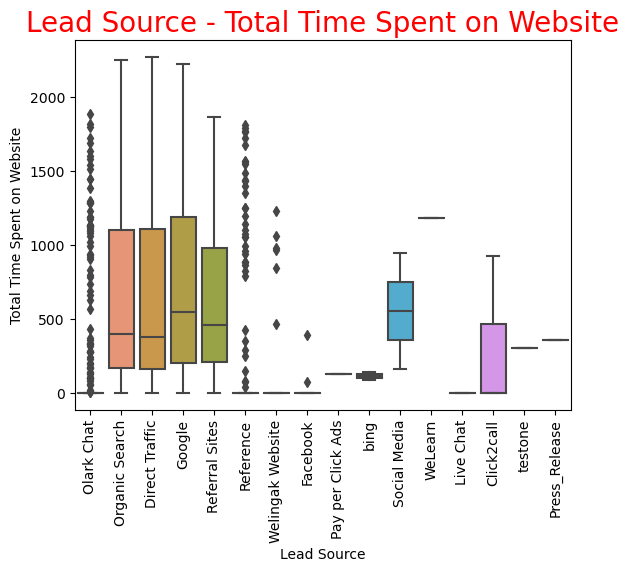

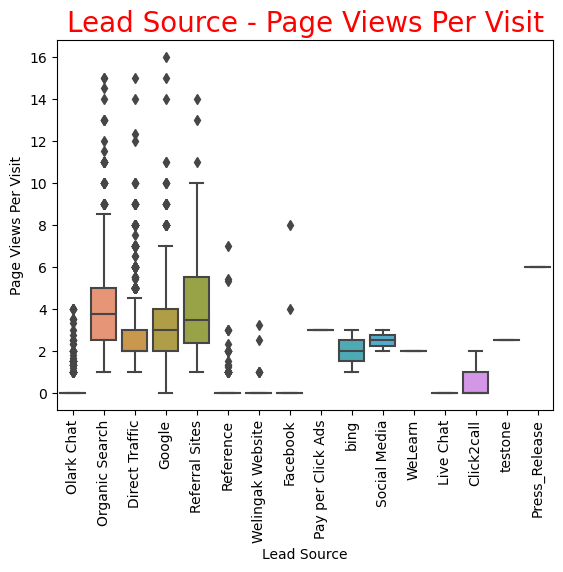

...

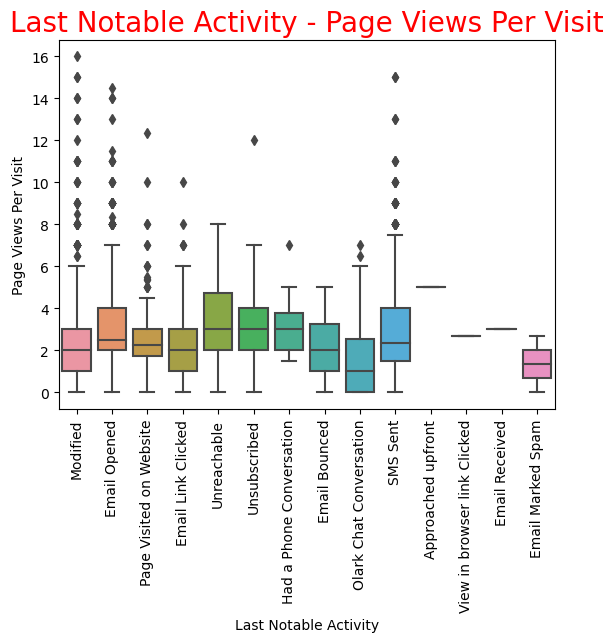

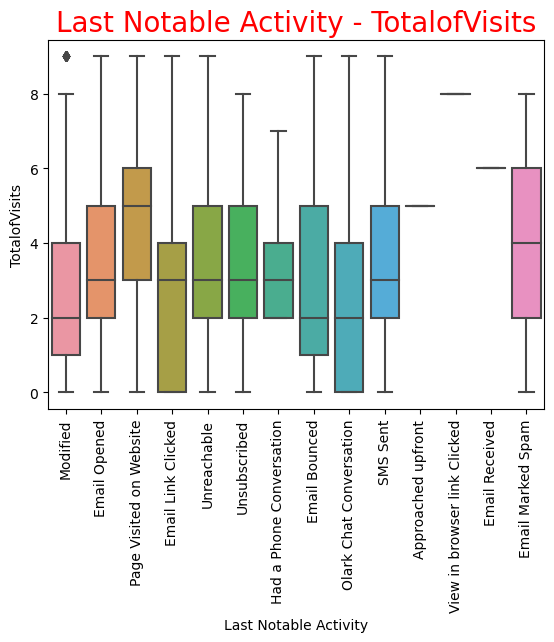

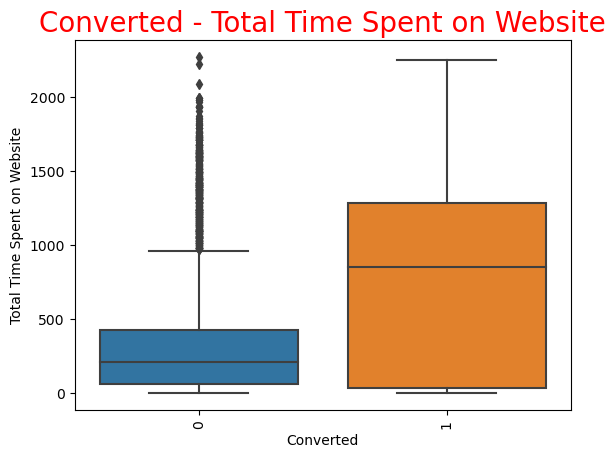

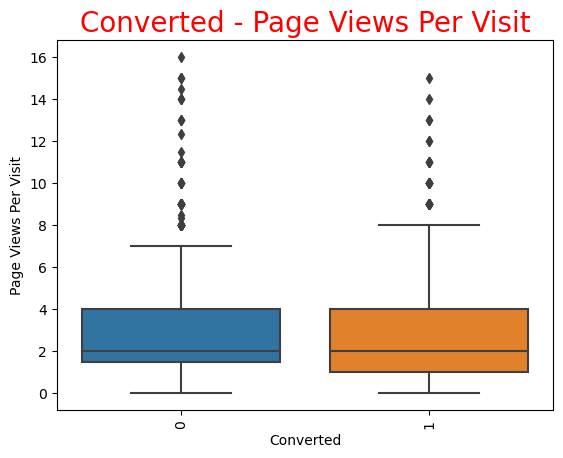

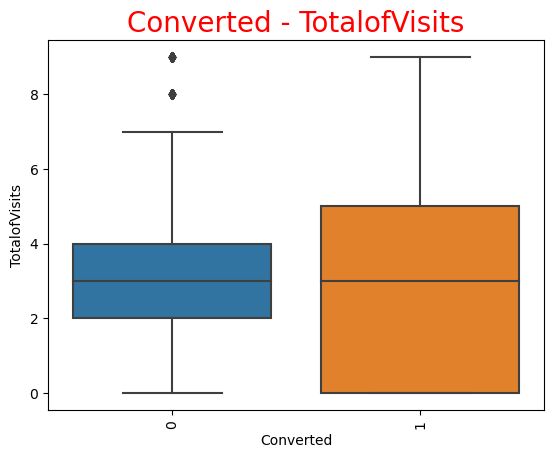

In [41]:
# Run the analysis again
for categorical_variable in categorical_variables:
    for numerical_variable in numerical_variables:
        sns.boxplot(data=df, x=categorical_variable, y=numerical_variable)
        plt.title(f'{categorical_variable} - {numerical_variable}', fontsize=20, color='red')
        plt.xticks(rotation=90)
        plt.show()

- Leads from "Landing Page Submission" spent more time on website, view more page per visit, have more total of visits than others.
- Customers who don't want to receive email spent more time on wesite.
- Customers who want a call spent more time on website and have more time of visits. On the other hand, customers who don't want a call view more page per visit.
- Customers who did not fill in form (default select option) spend less time on wesite, less number of visits than others.
- Customers came in through recommendation spent more time on Website, view more page per visit, have more total of visit.
- Customers who have tag "Interested in Next batch" spent more time on Website.
- Customers who have profile "DUal Specialization Student" spent more time on Website.
- Converted customers have total time spent on website significantly higher than those who is not.

#### Categorical - Categorical Analysis

In [42]:
# Loop through every categorical variables and group with target variable
for variable in categorical_variables:
    print(df.groupby([variable])['Converted'].value_counts(normalize=True))
    print('---------------------------------------------------------------------------')

Lead Origin              Converted
API                      0            0.616014
                         1            0.383986
Landing Page Submission  0            0.577791
                         1            0.422209
Lead Add Form            1            0.928571
                         0            0.071429
Lead Import              0            0.666667
                         1            0.333333
Name: Converted, dtype: float64
---------------------------------------------------------------------------
Lead Source        Converted
Click2call         1            0.666667
                   0            0.333333
Direct Traffic     0            0.630580
                   1            0.369420
Facebook           0            0.681818
                   1            0.318182
Google             0            0.528962
                   1            0.471038
Live Chat          1            1.000000
Olark Chat         0            0.648810
                   1            0.351190
O

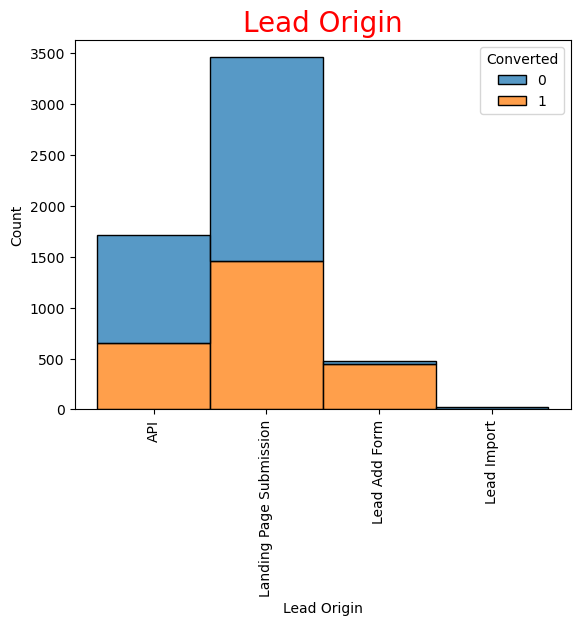

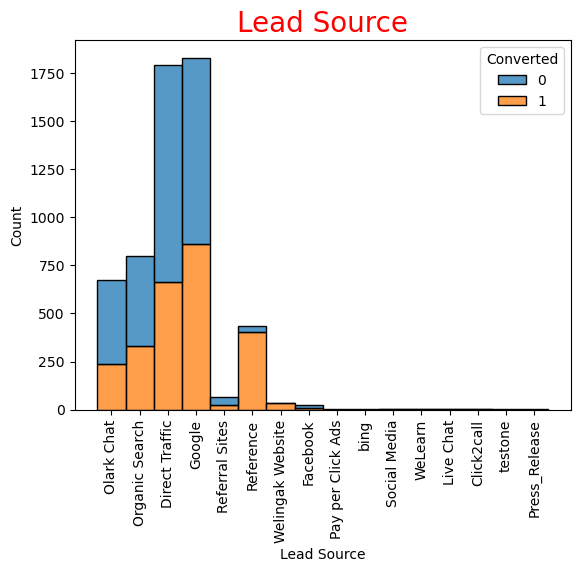

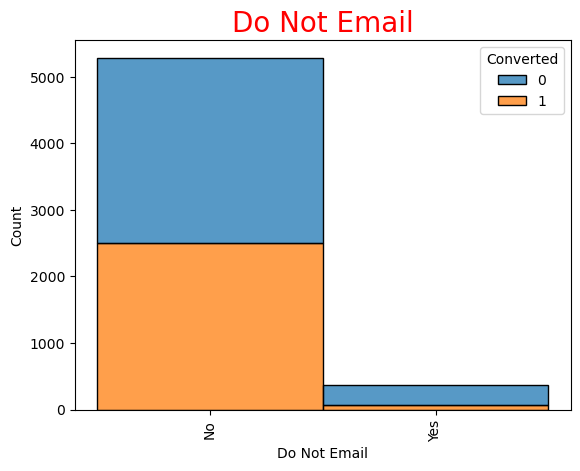

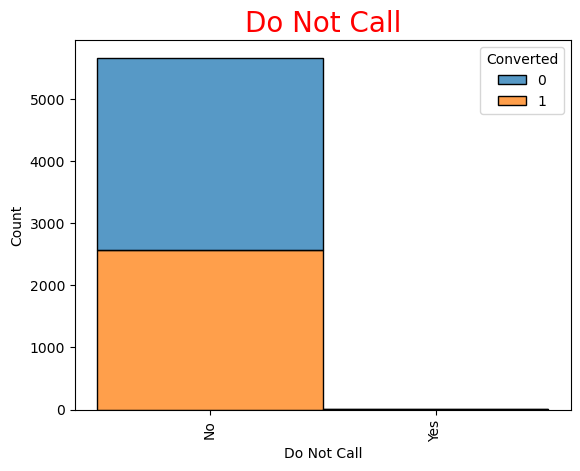

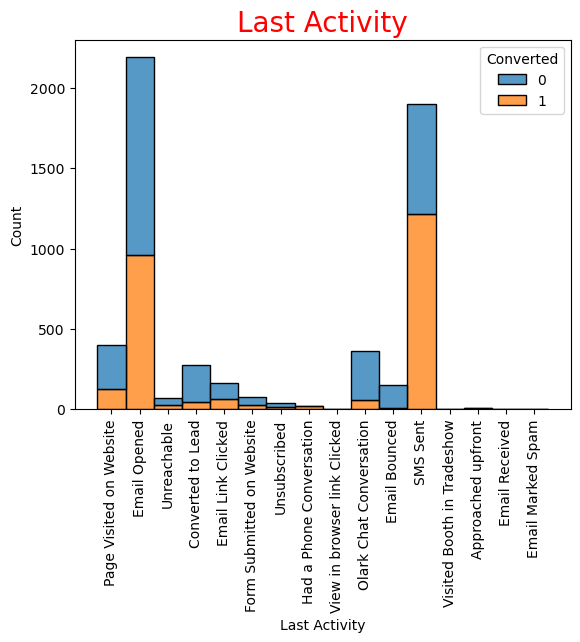

...

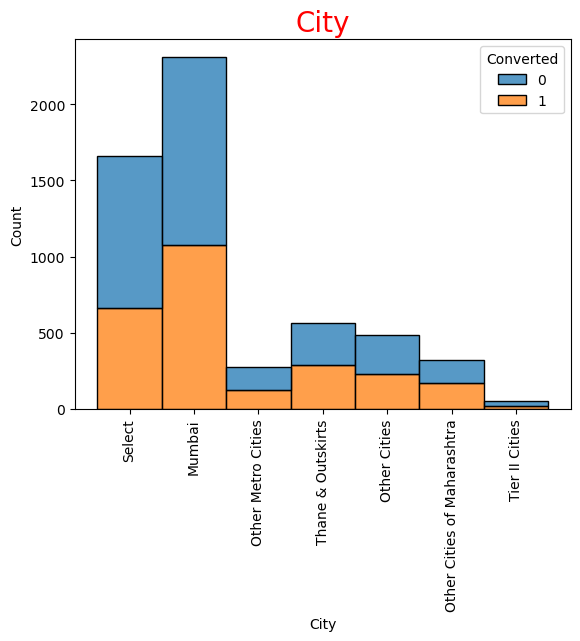

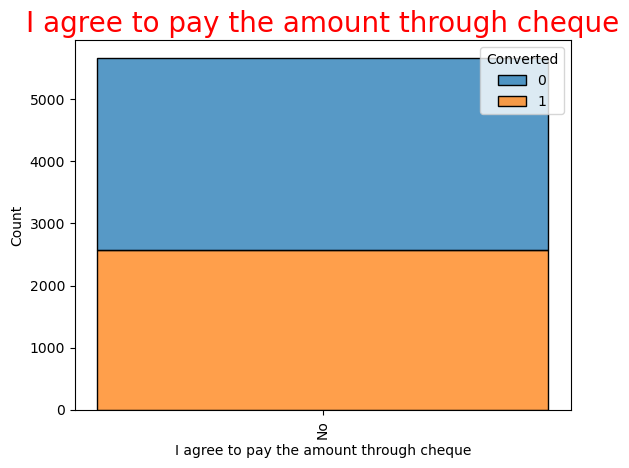

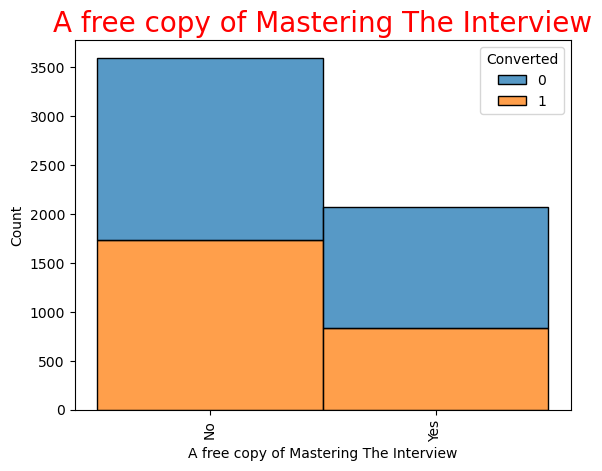

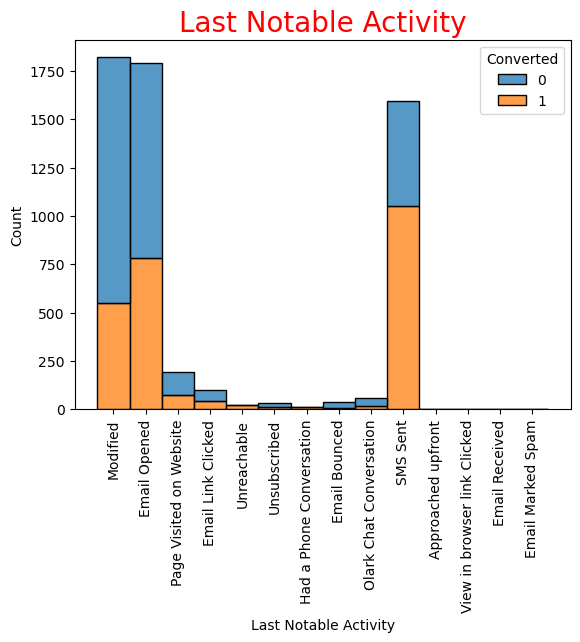

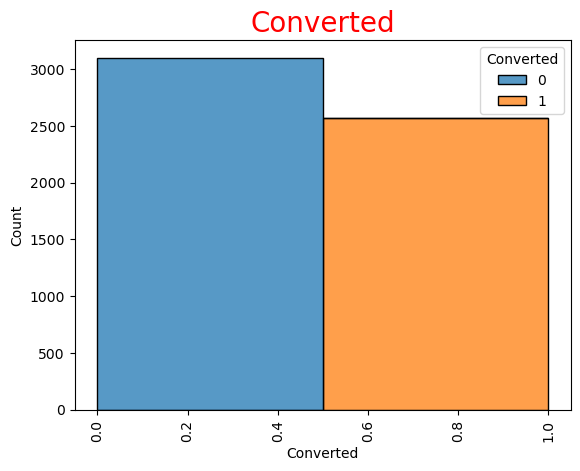

In [43]:
# Let's visualize
for variable in categorical_variables:
    sns.histplot(binwidth=0.5, x=variable, hue="Converted", data=df, stat="count", multiple="stack")
    plt.title(f'{variable}', fontsize=20, color='red')
    plt.xticks(rotation=90)
    plt.show()

- Tags "Will revert after reading the email", "Lost to EINS", "Closed by Horizzon" have very high conversion rate.
- Profile "Potential Lead" has very high conversion rate.
- Occupation "Working Professional" has very high conversion rate.

### Multivariate Analysis

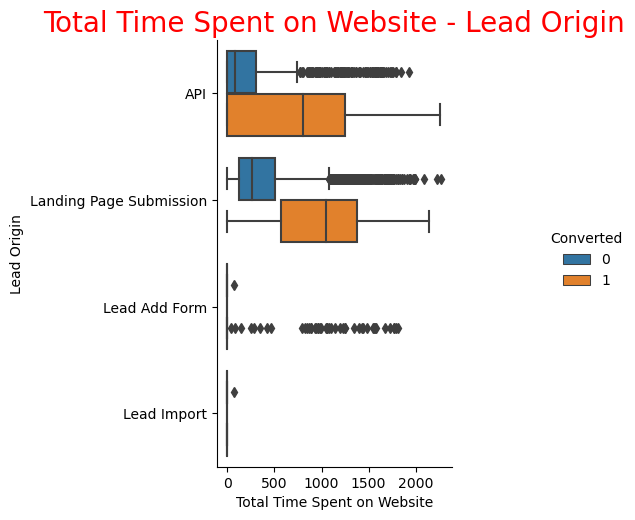

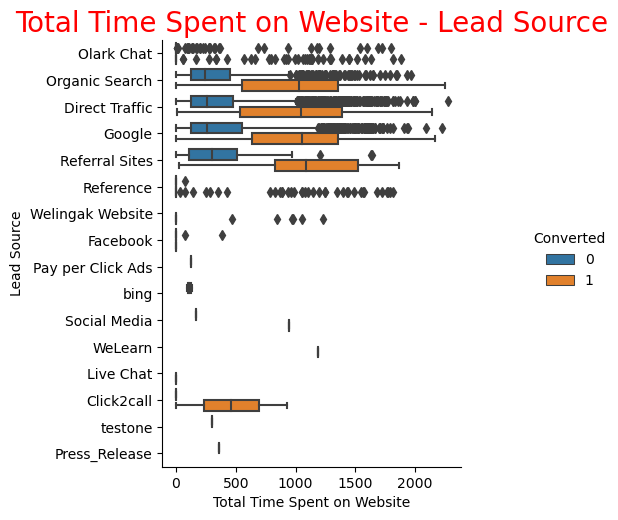

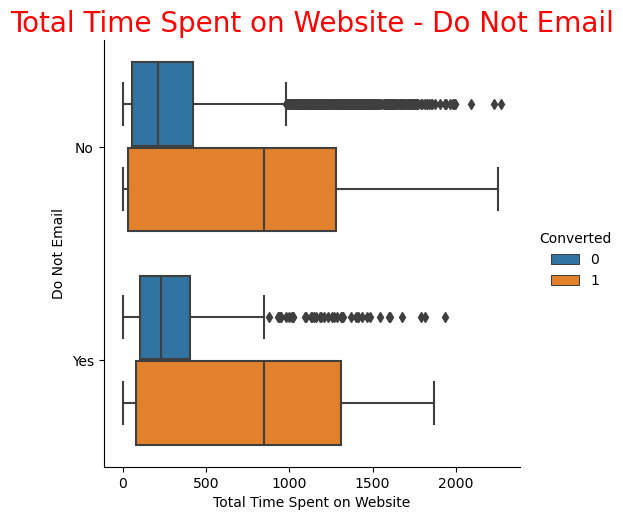

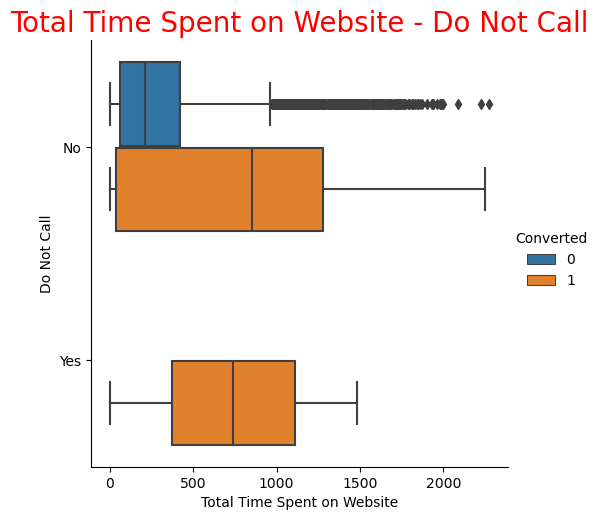

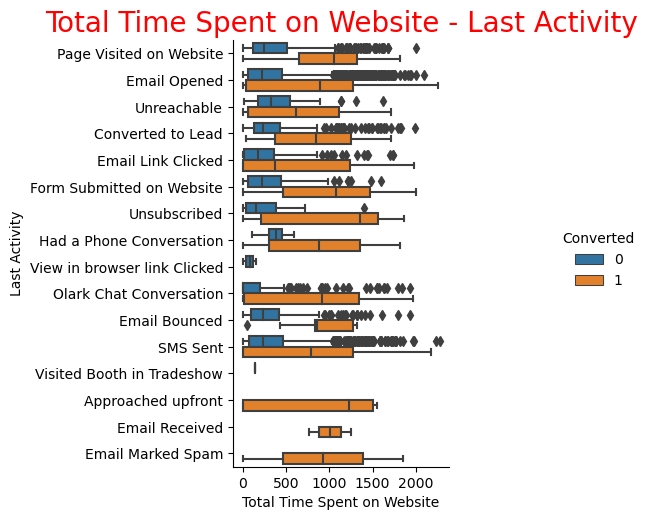

...

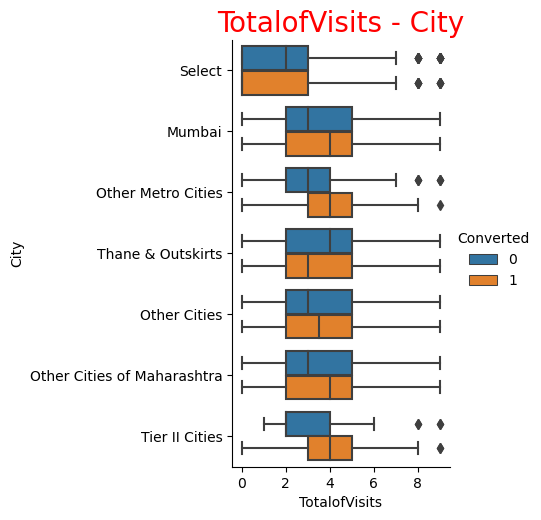

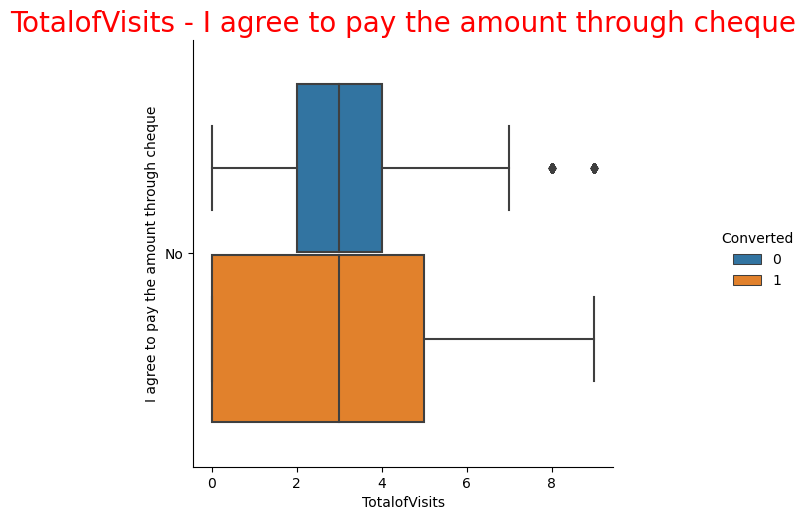

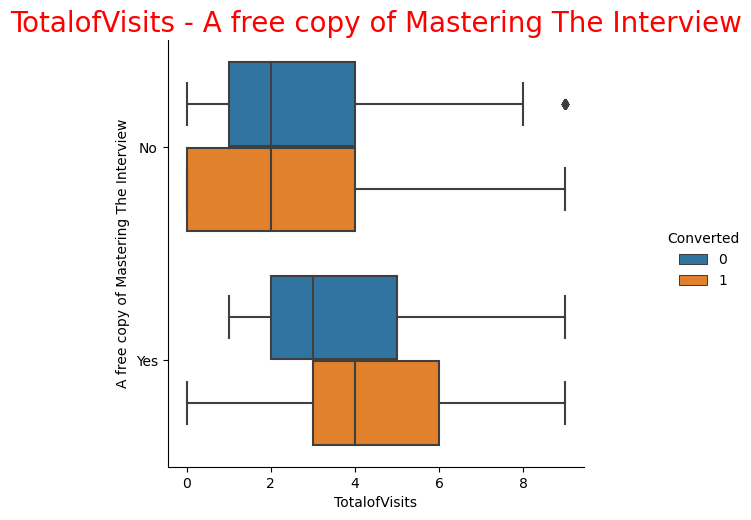

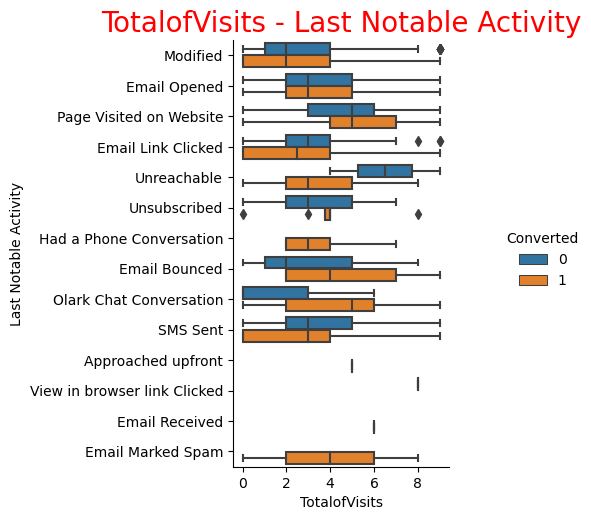

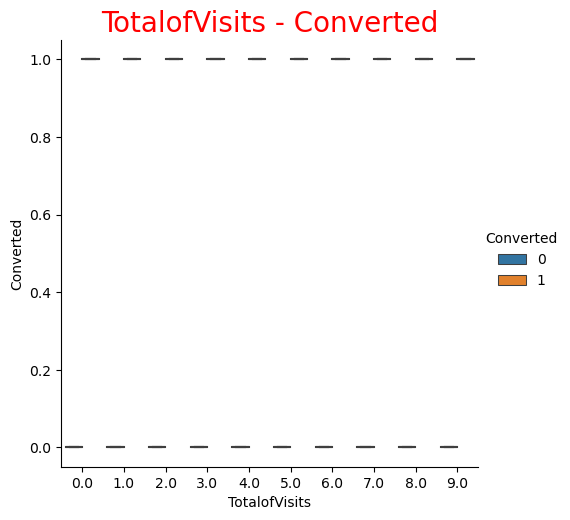

In [44]:
# Loop through numerical variables and categorical variables to have bigger view 
for numerical_variable in numerical_variables:
    for categorical_variable in categorical_variables:      
        sns.catplot(data=df, x=numerical_variable, y=categorical_variable, hue="Converted", kind="box")
        plt.title(numerical_variable + ' - ' + categorical_variable, fontsize=20, color='red')
        plt.show()

In [45]:
# Remove TotalofVisits because we have done the analysis
df.drop(['TotalofVisits'], axis=1, inplace=True)

# Data Preparation

#### Remove
We will remove variables that almost have only 1 option because there is no value from these:
- Do Not Call
- Search
- Magazine
- Newspaper Article
- X Education Forums
- Newspaper
- Digital Advertisement
- Through Recommendations
- Receive More Updates About Our Courses
- Update me on Supply Chain Content
- Get updates on DM Content
- I agree to pay the amount through cheque

In [46]:
variables_to_drop = ['Do Not Call', 'Search', 'Magazine', 'Newspaper Article', 'X Education Forums', 'Newspaper', 'Newspaper', 'Digital Advertisement', 'Through Recommendations', 'Receive More Updates About Our Courses', 'Update me on Supply Chain Content', 'Get updates on DM Content', 'I agree to pay the amount through cheque']
df.drop(variables_to_drop, axis=1, inplace=True)

#### Convert numerical variables to categorical variables

Total Visits, "Total Time Spent on Website", "Page Views Per visit" are right skewed

In [47]:
# Let's check TotalVisits
df.TotalVisits.describe()

count    5666.000000
mean        3.724497
std         4.921537
min         0.000000
25%         2.000000
50%         3.000000
75%         5.000000
max       251.000000
Name: TotalVisits, dtype: float64

In [48]:
# We will manually cut data into bins
bins = [-1, 2, 3, 5, 251]
df['TotalVisits'] = pd.cut(df['TotalVisits'], bins=bins, include_lowest=True)
df['TotalVisits']

0       (-1.001, 2.0]
1          (3.0, 5.0]
2       (-1.001, 2.0]
3       (-1.001, 2.0]
4       (-1.001, 2.0]
            ...      
9234       (3.0, 5.0]
9235     (5.0, 251.0]
9236    (-1.001, 2.0]
9237    (-1.001, 2.0]
9239     (5.0, 251.0]
Name: TotalVisits, Length: 5666, dtype: category
Categories (4, interval[float64, right]): [(-1.001, 2.0] < (2.0, 3.0] < (3.0, 5.0] < (5.0, 251.0]]

In [49]:
# Let's check TotalVisits
df['Page Views Per Visit'].describe()

count    5666.000000
mean        2.582031
std         2.062967
min         0.000000
25%         1.250000
50%         2.000000
75%         4.000000
max        16.000000
Name: Page Views Per Visit, dtype: float64

In [50]:
# We will manually cut data into bins
bins = [0, 1, 2, 4, 16]
df['Page Views Per Visit'] = pd.cut(df['Page Views Per Visit'], bins=bins, include_lowest=True)
df['Page Views Per Visit']

0       (-0.001, 1.0]
1          (2.0, 4.0]
2          (1.0, 2.0]
3       (-0.001, 1.0]
4       (-0.001, 1.0]
            ...      
9234       (2.0, 4.0]
9235       (2.0, 4.0]
9236       (1.0, 2.0]
9237       (1.0, 2.0]
9239       (2.0, 4.0]
Name: Page Views Per Visit, Length: 5666, dtype: category
Categories (4, interval[float64, right]): [(-0.001, 1.0] < (1.0, 2.0] < (2.0, 4.0] < (4.0, 16.0]]

#### Converting some binary variables (Yes/No) to 0/1

In [51]:
# Opportunity Status
df['Do Not Email'] = df['Do Not Email'].map({'Yes': 1, "No": 0})

In [52]:
# Check
df['Do Not Email'].head()

0    0
1    0
2    0
3    0
4    0
Name: Do Not Email, dtype: int64

In [53]:
df['Do Not Email'].value_counts()

0    5289
1     377
Name: Do Not Email, dtype: int64

In [54]:
# A free copy of Mastering The Interview
df['A free copy of Mastering The Interview'] = df['A free copy of Mastering The Interview'].map({'Yes': 1, "No": 0})

In [55]:
# Check
df['A free copy of Mastering The Interview'].head()

0    0
1    0
2    1
3    0
4    0
Name: A free copy of Mastering The Interview, dtype: int64

#### For categorical variables with multiple levels, create dummy features (one-hot encoded)

In [56]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5666 entries, 0 to 9239
Data columns (total 18 columns):
 #   Column                                  Non-Null Count  Dtype   
---  ------                                  --------------  -----   
 0   Lead Number                             5666 non-null   int64   
 1   Lead Origin                             5666 non-null   object  
 2   Lead Source                             5666 non-null   object  
 3   Do Not Email                            5666 non-null   int64   
 4   Converted                               5666 non-null   int64   
 5   TotalVisits                             5666 non-null   category
 6   Total Time Spent on Website             5666 non-null   int64   
 7   Page Views Per Visit                    5666 non-null   category
 8   Last Activity                           5666 non-null   object  
 9   Country                                 5666 non-null   object  
 10  Specialization                          5666 non

In [57]:
# Creating a dummy variable for some of the categorical variables and dropping the first one.
dummy1 = pd.get_dummies(df[['Lead Origin', 'Lead Source', 'TotalVisits', 'Page Views Per Visit','Last Activity', 'Country', 'Specialization', 'What is your current occupation', 'Tags', 'Last Notable Activity']], drop_first=True)

# Adding the results to the master dataframe
df = pd.concat([df, dummy1], axis=1)

In [58]:
# Creating dummy variables for the remaining categorical variables and dropping the level with "Select".

# How did you hear about X Education
h = pd.get_dummies(df['How did you hear about X Education'], prefix='How_did_you_hear_about_X_Education')
# Dropping 'Select'
h1 = h.drop(['How_did_you_hear_about_X_Education_Select'], 1)
#Adding the results to the master dataframe
df = pd.concat([df,h1], axis=1)

# Lead Profile
lp = pd.get_dummies(df['Lead Profile'], prefix='Lead_Profile')
# Dropping 'Select'
lp1 = lp.drop(['Lead_Profile_Select'], 1)
#Adding the results to the master dataframe
df = pd.concat([df,lp1], axis=1)

# City
c = pd.get_dummies(df['City'], prefix='City')
# Dropping 'Select'
c1 = c.drop(['City_Select'], 1)
#Adding the results to the master dataframe
df = pd.concat([df,c1], axis=1)

In [59]:
df['What is your current occupation'].value_counts()

Unemployed              4777
Working Professional     666
Student                  193
Other                     15
Housewife                  9
Businessman                6
Name: What is your current occupation, dtype: int64

In [60]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5666 entries, 0 to 9239
Columns: 169 entries, Lead Number to City_Tier II Cities
dtypes: category(2), int64(5), object(11), uint8(151)
memory usage: 1.7+ MB


In [61]:
df.head()

,Lead Number,Lead Origin,Lead Source,Do Not Email,Converted,TotalVisits,Total Time Spent on Website,Page Views Per Visit,Last Activity,Country,...,Lead_Profile_Lateral Student,Lead_Profile_Other Leads,Lead_Profile_Potential Lead,Lead_Profile_Student of SomeSchool,City_Mumbai,City_Other Cities,City_Other Cities of Maharashtra,City_Other Metro Cities,City_Thane & Outskirts,City_Tier II Cities
0,660737,API,Olark Chat,0,0,"(-1.001, 2.0]",0,"(-0.001, 1.0]",Page Visited on Website,India,...,0,0,0,0,0,0,0,0,0,0
1,660728,API,Organic Search,0,0,"(3.0, 5.0]",674,"(2.0, 4.0]",Email Opened,India,...,0,0,0,0,0,0,0,0,0,0
2,660727,Landing Page Submission,Direct Traffic,0,1,"(-1.001, 2.0]",1532,"(1.0, 2.0]",Email Opened,India,...,0,0,1,0,1,0,0,0,0,0
3,660719,Landing Page Submission,Direct Traffic,0,0,"(-1.001, 2.0]",305,"(-0.001, 1.0]",Unreachable,India,...,0,0,0,0,1,0,0,0,0,0
4,660681,Landing Page Submission,Google,0,1,"(-1.001, 2.0]",1428,"(-0.001, 1.0]",Converted to Lead,India,...,0,0,0,0,1,0,0,0,0,0


#### Dropping the repeated variables

In [62]:
# We have created dummies for the below variables, so we can drop them
df = df.drop(['Lead Origin', 'Lead Source', 'TotalVisits', 'Page Views Per Visit','Last Activity', 'Country', 'Specialization', 'What is your current occupation', 'Tags', 'Last Notable Activity', 'How did you hear about X Education', 'Lead Profile', 'City'], 1)

In [63]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5666 entries, 0 to 9239
Columns: 156 entries, Lead Number to City_Tier II Cities
dtypes: int64(5), uint8(151)
memory usage: 1.2 MB


### Test-Train Split

In [64]:
from sklearn.model_selection import train_test_split

In [65]:
# Putting feature variable to X
X = df.drop(['Converted','Lead Number'], axis=1)

X.head()

,Do Not Email,Total Time Spent on Website,A free copy of Mastering The Interview,Lead Origin_Landing Page Submission,Lead Origin_Lead Add Form,Lead Origin_Lead Import,Lead Source_Direct Traffic,Lead Source_Facebook,Lead Source_Google,Lead Source_Live Chat,...,Lead_Profile_Lateral Student,Lead_Profile_Other Leads,Lead_Profile_Potential Lead,Lead_Profile_Student of SomeSchool,City_Mumbai,City_Other Cities,City_Other Cities of Maharashtra,City_Other Metro Cities,City_Thane & Outskirts,City_Tier II Cities
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,674,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,1532,1,1,0,0,1,0,0,0,...,0,0,1,0,1,0,0,0,0,0
3,0,305,0,1,0,0,1,0,0,0,...,0,0,0,0,1,0,0,0,0,0
4,0,1428,0,1,0,0,0,0,1,0,...,0,0,0,0,1,0,0,0,0,0


In [66]:
# Putting response variable to y
y = df['Converted']

y.head()

0    0
1    0
2    1
3    0
4    1
Name: Converted, dtype: int64

In [67]:
# Splitting the data into train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, test_size=0.3, random_state=100)

## Feature Scaling

In [68]:
from sklearn.preprocessing import StandardScaler

In [69]:
scaler = StandardScaler()

X_train[['Total Time Spent on Website']] = scaler.fit_transform(X_train[['Total Time Spent on Website']])

X_train.head()

,Do Not Email,Total Time Spent on Website,A free copy of Mastering The Interview,Lead Origin_Landing Page Submission,Lead Origin_Lead Add Form,Lead Origin_Lead Import,Lead Source_Direct Traffic,Lead Source_Facebook,Lead Source_Google,Lead Source_Live Chat,...,Lead_Profile_Lateral Student,Lead_Profile_Other Leads,Lead_Profile_Potential Lead,Lead_Profile_Student of SomeSchool,City_Mumbai,City_Other Cities,City_Other Cities of Maharashtra,City_Other Metro Cities,City_Thane & Outskirts,City_Tier II Cities
4145,0,0.977481,1,1,0,0,0,0,1,0,...,0,0,0,0,1,0,0,0,0,0
8533,0,-0.697122,1,1,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3876,0,-0.958558,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7113,0,0.136647,1,1,0,0,0,0,1,0,...,0,0,1,0,1,0,0,0,0,0
7107,0,-0.907331,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0


In [70]:
X_train['Total Time Spent on Website'].head()

4145    0.977481
8533   -0.697122
3876   -0.958558
7113    0.136647
7107   -0.907331
Name: Total Time Spent on Website, dtype: float64

### Correlation

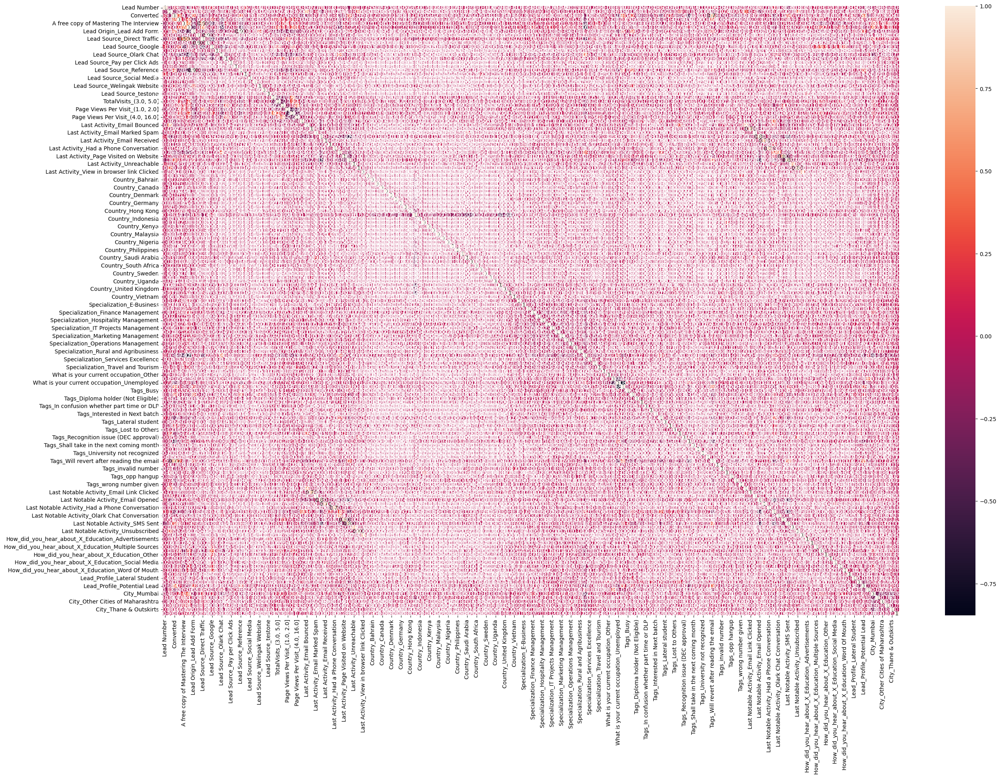

In [71]:
# Let's see the correlation matrix 
plt.figure(figsize = (30,20))        # Size of the figure
sns.heatmap(df.corr(),annot = True)
plt.show()

## Model Building

In [72]:
import statsmodels.api as sm

In [73]:
# Logistic regression model
logm1 = sm.GLM(y_train,(sm.add_constant(X_train)), family = sm.families.Binomial())
logm1.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 3966
Model:                            GLM   Df Residuals:                     3822
Model Family:                Binomial   Df Model:                          143
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Sun, 14 Jan 2024   Deviance:                       22750.
Time:                        12:04:10   Pearson chi2:                 1.11e+18
No. Iterations:                   100   Pseudo R-squ. (CS):                nan
Covariance Type:            nonrobust                                         
============================================================================================================================
                                                               coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------------------------------
const                                                     3.218e+15   9.65e+07   3.33e+07      0.000    3.22e+15    3.22e+15
Do Not Email                                             -7.176e+13   6.19e+06  -1.16e+07      0.000   -7.18e+13   -7.18e+13
Total Time Spent on Website                               2.282e+14   1.33e+06   1.72e+08      0.000    2.28e+14    2.28e+14
A free copy of Mastering The Interview                    -7.43e+13    4.1e+06  -1.81e+07      0.000   -7.43e+13   -7.43e+13
Lead Origin_Landing Page Submission                        1.78e+14   5.03e+06   3.54e+07      0.000    1.78e+14    1.78e+14
Lead Origin_Lead Add Form                                 3.452e+15   7.01e+07   4.93e+07      0.000    3.45e+15    3.45e+15
Lead Origin_Lead Import                                   1.296e+16   7.57e+07   1.71e+08      0.000     1.3e+16     1.3e+16
Lead Source_Direct Traffic                               -1.515e+15   8.47e+07  -1.79e+07      0.000   -1.52e+15   -1.52e+15
Lead Source_Facebook                                     -1.393e+16   1.12e+08  -1.24e+08      0.000   -1.39e+16   -1.39e+16
Lead Source_Google                                       -1.515e+15   8.46e+07  -1.79e+07      0.000   -1.52e+15   -1.52e+15
Lead Source_Live Chat                                    -2.227e+15   6.75e+07   -3.3e+07      0.000   -2.23e+15   -2.23e+15
Lead Source_Olark Chat                                   -1.206e+15   8.49e+07  -1.42e+07      0.000   -1.21e+15   -1.21e+15
Lead Source_Organic Search                               -1.422e+15   8.47e+07  -1.68e+07      0.000   -1.42e+15   -1.42e+15
Lead Source_Pay per Click Ads                              -17.6137   1.88e-06  -9.36e+06      0.000     -17.614     -17.614
Lead Source_Press_Release                                -6.935e+15   1.09e+08  -6.37e+07      0.000   -6.93e+15   -6.93e+15
Lead Source_Reference                                    -4.817e+15   4.79e+07     -1e+08      0.000   -4.82e+15   -4.82e+15
Lead Source_Referral Sites                                -1.07e+15   8.52e+07  -1.26e+07      0.000   -1.07e+15   -1.07e+15
Lead Source_Social Media                                  3.897e+15   1.09e+08   3.59e+07      0.000     3.9e+15     3.9e+15
Lead Source_WeLearn                                         76.5513   4.73e-06   1.62e+07      0.000      76.551      76.551
Lead Source_Welingak Website                             -3.506e+15   4.97e+07  -7.06e+07      0.000   -3.51e+15   -3.51e+15
Lead Source_bing                                         -1.233e+15   9.72e+07  -1.27e+07      0.000   -1.23e+15   -1.23e+15
Lead Source_testone                                      -2.426e+15   1.09e+08  -2.

## Feature Selection using RFE

In [74]:
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression()

In [75]:
from sklearn.feature_selection import RFE
rfe = RFE(logreg, n_features_to_select=15)             # running RFE with 15 variables as output
rfe = rfe.fit(X_train, y_train)

In [76]:
list(zip(X_train.columns, rfe.support_, rfe.ranking_))

[('Do Not Email', False, 20),
 ('Total Time Spent on Website', False, 9),
 ('A free copy of Mastering The Interview', False, 80),
 ('Lead Origin_Landing Page Submission', False, 115),
 ('Lead Origin_Lead Add Form', False, 8),
 ('Lead Origin_Lead Import', False, 55),
 ('Lead Source_Direct Traffic', False, 30),
 ('Lead Source_Facebook', False, 54),
 ('Lead Source_Google', False, 32),
 ('Lead Source_Live Chat', False, 106),
 ('Lead Source_Olark Chat', False, 51),
 ('Lead Source_Organic Search', False, 31),
 ('Lead Source_Pay per Click Ads', False, 132),
 ('Lead Source_Press_Release', False, 131),
 ('Lead Source_Reference', False, 104),
 ('Lead Source_Referral Sites', False, 63),
 ('Lead Source_Social Media', False, 82),
 ('Lead Source_WeLearn', False, 133),
 ('Lead Source_Welingak Website', False, 18),
 ('Lead Source_bing', False, 97),
 ('Lead Source_testone', False, 101),
 ('TotalVisits_(2.0, 3.0]', False, 37),
 ('TotalVisits_(3.0, 5.0]', False, 36),
 ('TotalVisits_(5.0, 251.0]', False, 

In [77]:
col = X_train.columns[rfe.support_]

##### Assessing the model with StatsModels


In [78]:
X_train_sm = sm.add_constant(X_train[col])
logm2 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res = logm2.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 3966
Model:                            GLM   Df Residuals:                     3950
Model Family:                Binomial   Df Model:                           15
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -529.30
Date:                Sun, 14 Jan 2024   Deviance:                       1058.6
Time:                        12:04:14   Pearson chi2:                 3.73e+03
No. Iterations:                    22   Pseudo R-squ. (CS):             0.6717
Covariance Type:            nonrobust                                         
=====================================================================================================================
                                                        coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------
const                                                -3.3594      0.241    -13.942      0.000      -3.832      -2.887
Last Activity_SMS Sent                                1.5059      0.201      7.506      0.000       1.113       1.899
Tags_Busy                                             2.6119      0.308      8.493      0.000       2.009       3.215
Tags_Closed by Horizzon                               8.7347      1.034      8.444      0.000       6.707      10.762
Tags_Interested in Next batch                        25.4196   5.62e+04      0.000      1.000    -1.1e+05     1.1e+05
Tags_Interested in other courses                     -0.7158      0.454     -1.578      0.115      -1.605       0.173
Tags_Lost to EINS                                     6.9194      0.689     10.043      0.000       5.569       8.270
Tags_Not doing further education                     -1.5433      1.038     -1.486      0.137      -3.578       0.492
Tags_Ringing                                         -0.8316      0.316     -2.634      0.008      -1.450      -0.213
Tags_Will revert after reading the email              6.2966      0.281     22.431      0.000       5.746       6.847
Tags_invalid number                                  -1.6085      1.069     -1.504      0.132      -3.704       0.487
Tags_switched off                                    -1.2582      0.567     -2.221      0.026      -2.369      -0.148
Tags_wrong number given                             -21.0801   1.48e+04     -0.001      0.999    -2.9e+04     2.9e+04
How_did_you_hear_about_X_Education_Advertisements     2.1382      0.718      2.979      0.003       0.732       3.545
Lead_Profile_Lateral Student                         24.1065   1.93e+04      0.001      0.999   -3.78e+04    3.78e+04
Lead_Profile_Student of SomeSchool                   -2.4811      0.857     -2.893      0.004      -4.162      -0.800
=====================================================================================================================
"""

In [79]:
col = col.delete(3)

In [80]:
col

Index(['Last Activity_SMS Sent', 'Tags_Busy', 'Tags_Closed by Horizzon',
       'Tags_Interested in other courses', 'Tags_Lost to EINS',
       'Tags_Not doing further education', 'Tags_Ringing',
       'Tags_Will revert after reading the email', 'Tags_invalid number',
       'Tags_switched off', 'Tags_wrong number given',
       'How_did_you_hear_about_X_Education_Advertisements',
       'Lead_Profile_Lateral Student', 'Lead_Profile_Student of SomeSchool'],
      dtype='object')

In [81]:
X_train_sm = sm.add_constant(X_train[col])
logm2 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res = logm2.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 3966
Model:                            GLM   Df Residuals:                     3951
Model Family:                Binomial   Df Model:                           14
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -533.19
Date:                Sun, 14 Jan 2024   Deviance:                       1066.4
Time:                        12:04:15   Pearson chi2:                 3.76e+03
No. Iterations:                    22   Pseudo R-squ. (CS):             0.6710
Covariance Type:            nonrobust                                         
=====================================================================================================================
                                                        coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------
const                                                -3.2853      0.232    -14.154      0.000      -3.740      -2.830
Last Activity_SMS Sent                                1.5531      0.200      7.758      0.000       1.161       1.946
Tags_Busy                                             2.5074      0.300      8.356      0.000       1.919       3.096
Tags_Closed by Horizzon                               8.6620      1.033      8.388      0.000       6.638      10.686
Tags_Interested in other courses                     -0.8004      0.449     -1.782      0.075      -1.681       0.080
Tags_Lost to EINS                                     6.8502      0.687      9.969      0.000       5.503       8.197
Tags_Not doing further education                     -1.6230      1.036     -1.566      0.117      -3.654       0.408
Tags_Ringing                                         -0.9382      0.308     -3.042      0.002      -1.543      -0.334
Tags_Will revert after reading the email              6.2129      0.273     22.760      0.000       5.678       6.748
Tags_invalid number                                  -1.7170      1.068     -1.608      0.108      -3.810       0.376
Tags_switched off                                    -1.3675      0.563     -2.431      0.015      -2.470      -0.265
Tags_wrong number given                             -21.1877   1.48e+04     -0.001      0.999    -2.9e+04    2.89e+04
How_did_you_hear_about_X_Education_Advertisements     2.1329      0.718      2.970      0.003       0.725       3.541
Lead_Profile_Lateral Student                         24.0186   1.91e+04      0.001      0.999   -3.75e+04    3.75e+04
Lead_Profile_Student of SomeSchool                   -2.5067      0.848     -2.957      0.003      -4.168      -0.845
=====================================================================================================================
"""

In [82]:
# Drop 'Tags_wrong number given'
col = col.delete(10)

In [83]:
X_train_sm = sm.add_constant(X_train[col])
logm2 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res = logm2.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 3966
Model:                            GLM   Df Residuals:                     3952
Model Family:                Binomial   Df Model:                           13
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -535.55
Date:                Sun, 14 Jan 2024   Deviance:                       1071.1
Time:                        12:04:15   Pearson chi2:                 3.76e+03
No. Iterations:                    21   Pseudo R-squ. (CS):             0.6707
Covariance Type:            nonrobust                                         
=====================================================================================================================
                                                        coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------
const                                                -3.3825      0.233    -14.488      0.000      -3.840      -2.925
Last Activity_SMS Sent                                1.5156      0.198      7.652      0.000       1.127       1.904
Tags_Busy                                             2.6288      0.298      8.835      0.000       2.046       3.212
Tags_Closed by Horizzon                               8.7567      1.033      8.478      0.000       6.732      10.781
Tags_Interested in other courses                     -0.6950      0.449     -1.548      0.122      -1.575       0.185
Tags_Lost to EINS                                     6.9395      0.687     10.106      0.000       5.594       8.285
Tags_Not doing further education                     -1.5217      1.036     -1.468      0.142      -3.553       0.510
Tags_Ringing                                         -0.8152      0.306     -2.666      0.008      -1.414      -0.216
Tags_Will revert after reading the email              6.3176      0.273     23.137      0.000       5.782       6.853
Tags_invalid number                                  -1.5930      1.066     -1.494      0.135      -3.683       0.497
Tags_switched off                                    -1.2423      0.561     -2.215      0.027      -2.342      -0.143
How_did_you_hear_about_X_Education_Advertisements     2.1406      0.718      2.981      0.003       0.733       3.548
Lead_Profile_Lateral Student                         23.1268   1.17e+04      0.002      0.998   -2.29e+04    2.29e+04
Lead_Profile_Student of SomeSchool                   -2.4722      0.860     -2.875      0.004      -4.157      -0.787
=====================================================================================================================
"""

In [84]:
# Drop 'Lead_Profile_Lateral Student'
col = col.delete(-2)

In [85]:
X_train_sm = sm.add_constant(X_train[col])
logm2 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res = logm2.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 3966
Model:                            GLM   Df Residuals:                     3953
Model Family:                Binomial   Df Model:                           12
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -539.33
Date:                Sun, 14 Jan 2024   Deviance:                       1078.7
Time:                        12:04:15   Pearson chi2:                 3.77e+03
No. Iterations:                     8   Pseudo R-squ. (CS):             0.6700
Covariance Type:            nonrobust                                         
=====================================================================================================================
                                                        coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------
const                                                -3.3298      0.229    -14.564      0.000      -3.778      -2.882
Last Activity_SMS Sent                                1.4993      0.197      7.606      0.000       1.113       1.886
Tags_Busy                                             2.5866      0.294      8.795      0.000       2.010       3.163
Tags_Closed by Horizzon                               8.7353      1.032      8.468      0.000       6.713      10.757
Tags_Interested in other courses                     -0.7437      0.447     -1.665      0.096      -1.619       0.131
Tags_Lost to EINS                                     6.8943      0.686     10.049      0.000       5.550       8.239
Tags_Not doing further education                     -1.5717      1.035     -1.518      0.129      -3.601       0.457
Tags_Ringing                                         -0.8565      0.302     -2.833      0.005      -1.449      -0.264
Tags_Will revert after reading the email              6.2770      0.269     23.323      0.000       5.749       6.804
Tags_invalid number                                  -1.6326      1.065     -1.533      0.125      -3.720       0.455
Tags_switched off                                    -1.2828      0.559     -2.295      0.022      -2.378      -0.187
How_did_you_hear_about_X_Education_Advertisements     2.1351      0.717      2.977      0.003       0.729       3.541
Lead_Profile_Student of SomeSchool                   -2.4958      0.855     -2.920      0.003      -4.171      -0.821
=====================================================================================================================
"""

In [86]:
# Drop 'Tags_Not doing further education'
col = col.delete(5)

In [87]:
X_train_sm = sm.add_constant(X_train[col])
logm2 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res = logm2.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 3966
Model:                            GLM   Df Residuals:                     3954
Model Family:                Binomial   Df Model:                           11
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -541.18
Date:                Sun, 14 Jan 2024   Deviance:                       1082.4
Time:                        12:04:15   Pearson chi2:                 3.75e+03
No. Iterations:                     8   Pseudo R-squ. (CS):             0.6697
Covariance Type:            nonrobust                                         
=====================================================================================================================
                                                        coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------
const                                                -3.4845      0.222    -15.707      0.000      -3.919      -3.050
Last Activity_SMS Sent                                1.5254      0.198      7.703      0.000       1.137       1.914
Tags_Busy                                             2.7257      0.291      9.357      0.000       2.155       3.297
Tags_Closed by Horizzon                               8.8838      1.030      8.625      0.000       6.865      10.903
Tags_Interested in other courses                     -0.5885      0.442     -1.330      0.183      -1.455       0.278
Tags_Lost to EINS                                     7.0318      0.683     10.292      0.000       5.693       8.371
Tags_Ringing                                         -0.7157      0.299     -2.391      0.017      -1.302      -0.129
Tags_Will revert after reading the email              6.4261      0.264     24.315      0.000       5.908       6.944
Tags_invalid number                                  -1.4759      1.060     -1.393      0.164      -3.553       0.601
Tags_switched off                                    -1.1454      0.558     -2.053      0.040      -2.239      -0.052
How_did_you_hear_about_X_Education_Advertisements     2.0093      0.697      2.884      0.004       0.644       3.375
Lead_Profile_Student of SomeSchool                   -2.4388      0.873     -2.795      0.005      -4.149      -0.729
=====================================================================================================================
"""

In [88]:
# Drop 'Tags_invalid number'
col = col.delete(-4)

In [89]:
X_train_sm = sm.add_constant(X_train[col])
logm2 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res = logm2.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 3966
Model:                            GLM   Df Residuals:                     3955
Model Family:                Binomial   Df Model:                           10
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -542.63
Date:                Sun, 14 Jan 2024   Deviance:                       1085.3
Time:                        12:04:15   Pearson chi2:                 3.73e+03
No. Iterations:                     8   Pseudo R-squ. (CS):             0.6695
Covariance Type:            nonrobust                                         
=====================================================================================================================
                                                        coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------
const                                                -3.5821      0.221    -16.233      0.000      -4.015      -3.150
Last Activity_SMS Sent                                1.4886      0.196      7.607      0.000       1.105       1.872
Tags_Busy                                             2.8482      0.286      9.953      0.000       2.287       3.409
Tags_Closed by Horizzon                               8.9796      1.030      8.721      0.000       6.962      10.998
Tags_Interested in other courses                     -0.4771      0.440     -1.084      0.278      -1.339       0.385
Tags_Lost to EINS                                     7.1229      0.682     10.441      0.000       5.786       8.460
Tags_Ringing                                         -0.5892      0.294     -2.006      0.045      -1.165      -0.014
Tags_Will revert after reading the email              6.5312      0.262     24.925      0.000       6.018       7.045
Tags_switched off                                    -1.0186      0.555     -1.836      0.066      -2.106       0.069
How_did_you_hear_about_X_Education_Advertisements     1.8944      0.694      2.730      0.006       0.534       3.254
Lead_Profile_Student of SomeSchool                   -2.4084      0.885     -2.723      0.006      -4.142      -0.675
=====================================================================================================================
"""

In [90]:
# Drop 'Tags_Interested in other courses'
col = col.delete(3)

In [91]:
X_train_sm = sm.add_constant(X_train[col])
logm2 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res = logm2.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 3966
Model:                            GLM   Df Residuals:                     3956
Model Family:                Binomial   Df Model:                            9
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -543.27
Date:                Sun, 14 Jan 2024   Deviance:                       1086.5
Time:                        12:04:15   Pearson chi2:                 3.77e+03
No. Iterations:                     8   Pseudo R-squ. (CS):             0.6694
Covariance Type:            nonrobust                                         
=====================================================================================================================
                                                        coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------
const                                                -3.7130      0.195    -19.064      0.000      -4.095      -3.331
Last Activity_SMS Sent                                1.5050      0.196      7.678      0.000       1.121       1.889
Tags_Busy                                             2.9687      0.271     10.969      0.000       2.438       3.499
Tags_Closed by Horizzon                               9.1061      1.025      8.888      0.000       7.098      11.114
Tags_Lost to EINS                                     7.2410      0.675     10.728      0.000       5.918       8.564
Tags_Ringing                                         -0.4690      0.279     -1.683      0.092      -1.015       0.077
Tags_Will revert after reading the email              6.6584      0.242     27.498      0.000       6.184       7.133
Tags_switched off                                    -0.8996      0.547     -1.644      0.100      -1.972       0.173
How_did_you_hear_about_X_Education_Advertisements     1.8751      0.694      2.701      0.007       0.514       3.236
Lead_Profile_Student of SomeSchool                   -2.3642      0.900     -2.628      0.009      -4.127      -0.601
=====================================================================================================================
"""

In [92]:
# Drop 'Tags_switched off'
col = col.delete(-3)

In [93]:
X_train_sm = sm.add_constant(X_train[col])
logm2 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res = logm2.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 3966
Model:                            GLM   Df Residuals:                     3957
Model Family:                Binomial   Df Model:                            8
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -544.92
Date:                Sun, 14 Jan 2024   Deviance:                       1089.8
Time:                        12:04:15   Pearson chi2:                 3.69e+03
No. Iterations:                     8   Pseudo R-squ. (CS):             0.6691
Covariance Type:            nonrobust                                         
=====================================================================================================================
                                                        coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------
const                                                -3.8363      0.190    -20.210      0.000      -4.208      -3.464
Last Activity_SMS Sent                                1.4424      0.191      7.543      0.000       1.068       1.817
Tags_Busy                                             3.1318      0.259     12.087      0.000       2.624       3.640
Tags_Closed by Horizzon                               9.2279      1.023      9.016      0.000       7.222      11.234
Tags_Lost to EINS                                     7.3583      0.673     10.936      0.000       6.040       8.677
Tags_Ringing                                         -0.3040      0.267     -1.138      0.255      -0.828       0.219
Tags_Will revert after reading the email              6.7947      0.236     28.840      0.000       6.333       7.256
How_did_you_hear_about_X_Education_Advertisements     1.9091      0.691      2.763      0.006       0.555       3.263
Lead_Profile_Student of SomeSchool                   -2.3289      0.916     -2.542      0.011      -4.124      -0.534
=====================================================================================================================
"""

In [94]:
# Drop Tags_Ringing
col = col.delete(4)

In [95]:
X_train_sm = sm.add_constant(X_train[col])
logm2 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res = logm2.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:              Converted   No. Observations:                 3966
Model:                            GLM   Df Residuals:                     3958
Model Family:                Binomial   Df Model:                            7
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -545.57
Date:                Sun, 14 Jan 2024   Deviance:                       1091.1
Time:                        12:04:15   Pearson chi2:                 3.66e+03
No. Iterations:                     8   Pseudo R-squ. (CS):             0.6690
Covariance Type:            nonrobust                                         
=====================================================================================================================
                                                        coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------
const                                                -3.9548      0.165    -23.981      0.000      -4.278      -3.632
Last Activity_SMS Sent                                1.4007      0.187      7.489      0.000       1.034       1.767
Tags_Busy                                             3.2770      0.229     14.281      0.000       2.827       3.727
Tags_Closed by Horizzon                               9.3447      1.019      9.169      0.000       7.347      11.342
Tags_Lost to EINS                                     7.4705      0.666     11.214      0.000       6.165       8.776
Tags_Will revert after reading the email              6.9221      0.212     32.680      0.000       6.507       7.337
How_did_you_hear_about_X_Education_Advertisements     1.9093      0.690      2.769      0.006       0.558       3.261
Lead_Profile_Student of SomeSchool                   -2.2961      0.931     -2.466      0.014      -4.121      -0.471
=====================================================================================================================
"""

#### Checking VIFs

In [96]:
# Check for the VIF values of the feature variables. 
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [97]:
# Create a dataframe that will contain the names of all the feature variables and their respective VIFs
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
1,Tags_Busy,1.06
3,Tags_Lost to EINS,1.01
5,How_did_you_hear_about_X_Education_Advertisements,1.01
2,Tags_Closed by Horizzon,1.00
6,Lead_Profile_Student of SomeSchool,1.00
4,Tags_Will revert after reading the email,0.15
0,Last Activity_SMS Sent,0.06


Model looks good

In [98]:
# Getting the predicted values on the train set
y_train_pred = res.predict(X_train_sm)
y_train_pred[:10]

4145    0.951076
8533    0.018802
3876    0.072153
7113    0.987483
7107    0.018802
2399    0.987483
1640    0.018802
2900    0.951076
2243    0.951076
3608    0.951076
dtype: float64

In [99]:
y_train_pred = y_train_pred.values.reshape(-1)
y_train_pred[:10]

array([0.95107588, 0.01880205, 0.07215323, 0.98748282, 0.01880205,
       0.98748282, 0.01880205, 0.95107588, 0.95107588, 0.95107588])

##### Creating a dataframe with the actual converted flag and the predicted probabilities

In [100]:
y_train_pred_final = pd.DataFrame({'Converted':y_train.values, 'Converted_Prob':y_train_pred})
y_train_pred_final['Lead Number'] = y_train.index
y_train_pred_final.head()

,Converted,Converted_Prob,Lead Number
0,0,0.951076,4145
1,0,0.018802,8533
2,0,0.072153,3876
3,1,0.987483,7113
4,0,0.018802,7107


In [101]:
y_train_pred_final

,Converted,Converted_Prob,Lead Number
0,0,0.951076,4145
1,0,0.018802,8533
2,0,0.072153,3876
3,1,0.987483,7113
4,0,0.018802,7107
...,...,...,...
3961,1,0.987483,3233
3962,0,0.018802,595
3963,1,0.951076,110
3964,0,0.072153,6603


### Creating new column 'predicted' with 1 if Converted > 0.5 else 0

In [102]:
y_train_pred_final['predicted'] = y_train_pred_final.Converted_Prob.map(lambda x: 1 if x > 0.5 else 0)

# Let's see the head
y_train_pred_final.head()

,Converted,Converted_Prob,Lead Number,predicted
0,0,0.951076,4145,1
1,0,0.018802,8533,0
2,0,0.072153,3876,0
3,1,0.987483,7113,1
4,0,0.018802,7107,0


In [103]:
from sklearn import metrics

In [104]:
# Confusion matrix 
confusion = metrics.confusion_matrix(y_train_pred_final['Converted'], y_train_pred_final.predicted )
print(confusion)

[[2053   78]
 [  82 1753]]


In [105]:
# Predicted     no      yes
# Actual
# no          2053       78
# yes           82     1753  

In [106]:
# Let's check the overall accuracy.
print(metrics.accuracy_score(y_train_pred_final['Converted'], y_train_pred_final.predicted))

0.9596570852244075


## Metrics beyond simply accuracy

In [107]:
TP = confusion[1,1] # true positive 
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives

In [108]:
# Let's see the sensitivity of our logistic regression model
TP / float(TP+FN)

0.9553133514986376

In [109]:
# Let us calculate specificity
TN / float(TN+FP)

0.9633974659784139

In [110]:
# Let us calculate precision
TP / float(TP+FP)

0.957400327689787

In [111]:
# Let us calculate recall
TP / float(TP+FN)

0.9553133514986376

In [112]:
# Calculate false postive rate - predicting won when it loss
print(FP/ float(TN+FP))

0.03660253402158611


In [113]:
# positive predictive value 
print (TP / float(TP+FP))

0.957400327689787


In [114]:
# Negative predictive value
print (TN / float(TN+ FN))

0.9615925058548009


### Finding Optimal Cutoff Point

In this project, the CEO has given a ballpark of the target lead conversion rate to be around 80%.

Let's translate this into techinical language. This means we care about the ratio between true positive and false positive. So we will use Precision and Recall metrics to evaluate our model. The Precision must be around 80% and the recall as high as possible because we don't want to miss too much potential leads.

In [115]:
# Let's create columns with different probability cutoffs 
numbers = [float(x)/10 for x in range(10)]
for i in numbers:
    y_train_pred_final[i]= y_train_pred_final.Converted_Prob.map(lambda x: 1 if x > i else 0)
y_train_pred_final.head()

,Converted,Converted_Prob,Lead Number,predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9
0,0,0.951076,4145,1,1,1,1,1,1,1,1,1,1,1
1,0,0.018802,8533,0,1,0,0,0,0,0,0,0,0,0
2,0,0.072153,3876,0,1,0,0,0,0,0,0,0,0,0
3,1,0.987483,7113,1,1,1,1,1,1,1,1,1,1,1
4,0,0.018802,7107,0,1,0,0,0,0,0,0,0,0,0


In [116]:
# Now let's calculate accuracy precision and recall for various probability cutoffs.
cutoff_df = pd.DataFrame( columns = ['prob','accuracy','precision','recall'])
from sklearn.metrics import confusion_matrix

# TP = confusion[1,1] # true positive 
# TN = confusion[0,0] # true negatives
# FP = confusion[0,1] # false positives
# FN = confusion[1,0] # false negatives

num = [0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
for i in num:
    cm1 = metrics.confusion_matrix(y_train_pred_final['Converted'], y_train_pred_final[i] )
    total1=sum(sum(cm1))
    accuracy = (cm1[0,0]+cm1[1,1])/total1
    
    precision = cm1[1,1]/(cm1[0,1]+cm1[1,1])
    recall = cm1[1,1]/(cm1[1,0]+cm1[1,1])
    cutoff_df.loc[i] =[ i ,accuracy,precision,recall]
print(cutoff_df)

     prob  accuracy  precision    recall
0.0   0.0  0.462683   0.462683  1.000000
0.1   0.1  0.955623   0.939121  0.966757
0.2   0.2  0.957388   0.943085  0.966213
0.3   0.3  0.957388   0.943085  0.966213
0.4   0.4  0.959657   0.957400  0.955313
0.5   0.5  0.959657   0.957400  0.955313
0.6   0.6  0.959657   0.957400  0.955313
0.7   0.7  0.954866   0.973684  0.927520
0.8   0.8  0.953606   0.973609  0.924796
0.9   0.9  0.953606   0.973609  0.924796


In [117]:
# Let's create columns with different probability cutoffs between 0.0 and 0.1
numbers = [0.0,0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08,0.09,0.1]
for i in numbers:
    y_train_pred_final[i]= y_train_pred_final.Converted_Prob.map(lambda x: 1 if x > i else 0)
y_train_pred_final.head()

,Converted,Converted_Prob,Lead Number,predicted,0.0,0.1,0.2,0.3,0.4,0.5,...,0.9,0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08,0.09
0,0,0.951076,4145,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
1,0,0.018802,8533,0,1,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
2,0,0.072153,3876,0,1,0,0,0,0,0,...,0,1,1,1,1,1,1,1,0,0
3,1,0.987483,7113,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
4,0,0.018802,7107,0,1,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0


In [118]:
# Now let's see the interval 0.0 and 0.1
cutoff_df = pd.DataFrame( columns = ['prob','accuracy','precision','recall'])
from sklearn.metrics import confusion_matrix

# TP = confusion[1,1] # true positive 
# TN = confusion[0,0] # true negatives
# FP = confusion[0,1] # false positives
# FN = confusion[1,0] # false negatives

num = [0.0,0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08,0.09,0.1]
for i in num:
    cm1 = metrics.confusion_matrix(y_train_pred_final['Converted'], y_train_pred_final[i] )
    total1=sum(sum(cm1))
    accuracy = (cm1[0,0]+cm1[1,1])/total1
    
    precision = cm1[1,1]/(cm1[0,1]+cm1[1,1])
    recall = cm1[1,1]/(cm1[1,0]+cm1[1,1])
    cutoff_df.loc[i] =[ i ,accuracy,precision,recall]
print(cutoff_df)

      prob  accuracy  precision    recall
0.00  0.00  0.462683   0.462683  1.000000
0.01  0.01  0.505295   0.483276  1.000000
0.02  0.02  0.858043   0.771100  0.985831
0.03  0.03  0.858043   0.771100  0.985831
0.04  0.04  0.858043   0.771100  0.985831
0.05  0.05  0.858043   0.771100  0.985831
0.06  0.06  0.858043   0.771100  0.985831
0.07  0.07  0.858043   0.771100  0.985831
0.08  0.08  0.955623   0.939121  0.966757
0.09  0.09  0.955623   0.939121  0.966757
0.10  0.10  0.955623   0.939121  0.966757


We can see that the optimal point is 0.1 because the recall is highest and the precision > 80%

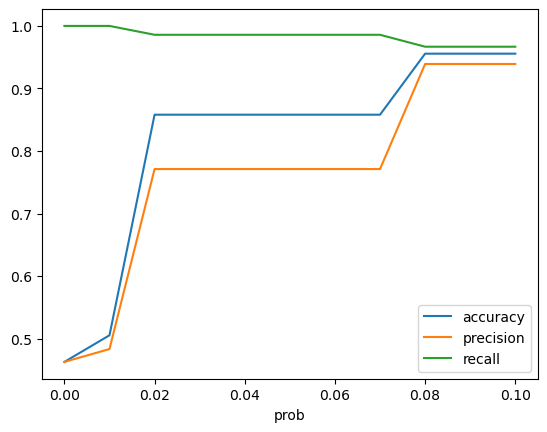

In [119]:
# Let's plot accuracy sensitivity and specificity for various probabilities.
cutoff_df.plot.line(x='prob', y=['accuracy','precision','recall'])
plt.show()

#### 0.1 is the optimum point to take it as a cutoff probability.

In [120]:
y_train_pred_final['final_predicted'] = y_train_pred_final.Converted_Prob.map( lambda x: 1 if x > 0.1 else 0)

y_train_pred_final.head()

,Converted,Converted_Prob,Lead Number,predicted,0.0,0.1,0.2,0.3,0.4,0.5,...,0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08,0.09,final_predicted
0,0,0.951076,4145,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
1,0,0.018802,8533,0,1,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
2,0,0.072153,3876,0,1,0,0,0,0,0,...,1,1,1,1,1,1,1,0,0,0
3,1,0.987483,7113,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
4,0,0.018802,7107,0,1,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0


In [121]:
# Let's check the overall accuracy.
metrics.accuracy_score(y_train_pred_final['Converted'], y_train_pred_final.final_predicted)

0.9556227937468482

In [122]:
# Let's see the confusion matrix
confusion = metrics.confusion_matrix(y_train_pred_final['Converted'], y_train_pred_final.final_predicted )
confusion

array([[2016,  115],
       [  61, 1774]], dtype=int64)

In [123]:
TP = confusion[1,1] # true positive 
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives

In [124]:
# Let's see the recall of our logistic regression model
TP / float(TP+FN)

0.9667574931880109

In [125]:
# Let's calculate precision
TP / float(TP+FP)

0.9391212281630492

In [126]:
# Calculate false postive rate - predicting won when it loss
print(FP/ float(TN+FP))

0.05396527451900516


In [127]:
# Positive predictive value 
print (TP / float(TP+FP))

0.9391212281630492


In [128]:
# Negative predictive value
print (TN / float(TN+ FN))

0.9706307173808377


### Making predictions on the test set

In [129]:
X_test[['Total Time Spent on Website']] = scaler.transform(X_test[['Total Time Spent on Website']])

In [130]:
X_test = X_test[col]
X_test.head()

,Last Activity_SMS Sent,Tags_Busy,Tags_Closed by Horizzon,Tags_Lost to EINS,Tags_Will revert after reading the email,How_did_you_hear_about_X_Education_Advertisements,Lead_Profile_Student of SomeSchool
1392,0,0,0,0,0,0,0
3123,0,0,0,0,1,0,0
8181,1,0,0,0,0,0,0
3791,0,0,0,0,0,0,0
4318,1,0,0,0,1,0,0


In [131]:
X_test_sm = sm.add_constant(X_test)

Making predictions on the test set

In [132]:
y_test_pred = res.predict(X_test_sm)

In [133]:
y_test_pred[:10]

1392    0.018802
3123    0.951076
8181    0.072153
3791    0.018802
4318    0.987483
6302    0.995458
5010    0.995458
344     0.018802
6483    0.001925
7820    0.951076
dtype: float64

In [134]:
# Converting y_pred to a dataframe which is an array
y_pred_1 = pd.DataFrame(y_test_pred)

In [135]:
# Let's see the head
y_pred_1.head()

,0
1392,0.018802
3123,0.951076
8181,0.072153
3791,0.018802
4318,0.987483


In [136]:
# Converting y_test to dataframe
y_test_df = pd.DataFrame(y_test)

In [137]:
# Putting Opportunity ID to index
y_test_df['Lead Number'] = y_test_df.index

In [138]:
# Removing index for both dataframes to append them side by side 
y_pred_1.reset_index(drop=True, inplace=True)
y_test_df.reset_index(drop=True, inplace=True)

In [139]:
# Appending y_test_df and y_pred_1
y_pred_final = pd.concat([y_test_df, y_pred_1],axis=1)

In [140]:
y_pred_final.head()

,Converted,Lead Number,0
0,0,1392,0.018802
1,1,3123,0.951076
2,0,8181,0.072153
3,0,3791,0.018802
4,1,4318,0.987483


In [141]:
# Renaming the column 
y_pred_final= y_pred_final.rename(columns={ 0 : 'Converted_Prob'})

In [142]:
# Rearranging the columns
y_pred_final = y_pred_final.reindex(['Lead Number','Converted','Converted_Prob'], axis=1)

In [143]:
# Let's see the head of y_pred_final
y_pred_final.head()

,Lead Number,Converted,Converted_Prob
0,1392,0,0.018802
1,3123,1,0.951076
2,8181,0,0.072153
3,3791,0,0.018802
4,4318,1,0.987483


In [144]:
y_pred_final['final_predicted'] = y_pred_final.Converted_Prob.map(lambda x: 1 if x > 0.1 else 0)

In [145]:
y_pred_final.head()

,Lead Number,Converted,Converted_Prob,final_predicted
0,1392,0,0.018802,0
1,3123,1,0.951076,1
2,8181,0,0.072153,0
3,3791,0,0.018802,0
4,4318,1,0.987483,1


In [146]:
# Let's check the overall accuracy.
metrics.accuracy_score(y_pred_final['Converted'], y_pred_final.final_predicted)

0.9570588235294117

In [147]:
confusion2 = metrics.confusion_matrix(y_pred_final['Converted'], y_pred_final.final_predicted )
confusion2

array([[919,  50],
       [ 23, 708]], dtype=int64)

In [148]:
TP = confusion2[1,1] # true positive 
TN = confusion2[0,0] # true negatives
FP = confusion2[0,1] # false positives
FN = confusion2[1,0] # false negatives

In [149]:
# Let's see the sensitivity of our logistic regression model
TP / float(TP+FN)

0.9685362517099864

In [150]:
# Let us calculate specificity
TN / float(TN+FP)

0.9484004127966976

In [151]:
# Let's see the precision of our logistic regression model
confusion2[1,1]/(confusion2[0,1]+confusion2[1,1])

0.9340369393139841

In [152]:
# Let's see the recall of our logistic regression model
confusion2[1,1]/(confusion2[1,0]+confusion2[1,1])

0.9685362517099864

In [153]:
# Calculate false postive rate - predicting yes when it is no
print(FP/ float(TN+FP))

0.05159958720330237


In [154]:
# Positive predictive value 
print (TP / float(TP+FP))

0.9340369393139841


In [155]:
# Negative predictive value
print (TN / float(TN+ FN))

0.975583864118896


Training Set:
- Precision: 0.94
- Recall: 0.97
- Accuracy: 0.96

Test Set:
- Precision: 0.93
- Recall: 0.97
- Accuracy: 0.96

The result show that this is a good model that can be used to predict various datasets.

### Create "Score" variable for Lead Score as business requirement

Lead score is between 0 and 100 to each of the leads which can be used by the company to target potential leads. A higher score would mean that the lead is hot, i.e. is most likely to convert whereas a lower score would mean that the lead is cold and will mostly not get converted.

We can calulate lead score by using Converted_Prob because higher Converted_Probe is, the higher chance that lead is converted.

In [156]:
# First, we calculate Lead Score from y_pred_final
y_pred_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1700 entries, 0 to 1699
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Lead Number      1700 non-null   int64  
 1   Converted        1700 non-null   int64  
 2   Converted_Prob   1700 non-null   float64
 3   final_predicted  1700 non-null   int64  
dtypes: float64(1), int64(3)
memory usage: 53.3 KB


In [157]:
# Calculate Lead Score from y_pred_final
y_pred_final['Score'] = y_pred_final['Converted_Prob'] * 100

In [158]:
# Check
y_pred_final['Score'].head()

0     1.880205
1    95.107588
2     7.215323
3     1.880205
4    98.748282
Name: Score, dtype: float64

In [159]:
# Next, we calculate Lead Score from y_train_pred_final
y_train_pred_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3966 entries, 0 to 3965
Data columns (total 24 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Converted        3966 non-null   int64  
 1   Converted_Prob   3966 non-null   float64
 2   Lead Number      3966 non-null   int64  
 3   predicted        3966 non-null   int64  
 4   0.0              3966 non-null   int64  
 5   0.1              3966 non-null   int64  
 6   0.2              3966 non-null   int64  
 7   0.3              3966 non-null   int64  
 8   0.4              3966 non-null   int64  
 9   0.5              3966 non-null   int64  
 10  0.6              3966 non-null   int64  
 11  0.7              3966 non-null   int64  
 12  0.8              3966 non-null   int64  
 13  0.9              3966 non-null   int64  
 14  0.01             3966 non-null   int64  
 15  0.02             3966 non-null   int64  
 16  0.03             3966 non-null   int64  
 17  0.04          

In [160]:
# Calculate Lead Score from y_pred_final
y_train_pred_final['Score'] = y_train_pred_final['Converted_Prob'] * 100

In [161]:
# Check
y_train_pred_final['Score'].head()

0    95.107588
1     1.880205
2     7.215323
3    98.748282
4     1.880205
Name: Score, dtype: float64

In [162]:
# Final list
pred_final = pd.concat([y_pred_final[['Lead Number', 'Score']], y_train_pred_final[['Lead Number', 'Score']]])
pred_final.head()

,Lead Number,Score
0,1392,1.880205
1,3123,95.107588
2,8181,7.215323
3,3791,1.880205
4,4318,98.748282


# Conclusion

By applying our final model, leads with "Opportunity Status" score > 10 are considered potentials leads. And this will turn the rate of conversion to 80%.

Based on the model, top 3 important variables are:
- Tags_Closed by Horizzon: with coef of 9.3447	
- Tags_Lost to EINS: with coef of 7.4705	
- Tags_Will revert after reading the email: with coef of 6.9221	